# Snow changes

In [2]:
#Functions and otherwise...

from netCDF4 import Dataset
import pylab as P
import numpy as np
from numpy import ma
from numpy import dtype
import matplotlib
import cartopy.crs as crs
import cartopy.feature as cfeature
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import matplotlib.colors as colors
import matplotlib.ticker as mticker
import matplotlib.gridspec as gridspec
import xarray as xr
import pandas as pd
import os
from scipy.interpolate import griddata
import wrf
from wrf import (getvar, to_np, vertcross, smooth2d, CoordPair, GeoBounds,
                 get_cartopy, latlon_coords, cartopy_xlim, cartopy_ylim)
import xesmf as xe
import dask
import gc
import datetime
import time
import scipy
import scipy.stats

states = cfeature.NaturalEarthFeature(category='cultural', scale='50m',
                                      facecolor='none',
                                      name='admin_1_states_provinces_shp')


roll = 122  #days between 1 Sept and 1 Jan
bad = -999
dir_out = "/home/tornerdo/WRF/pics/"

#Read meta
def _metaread(dir_meta,domain):
 file = "%swrfinput_%s" %(dir_meta,domain)
 data = xr.open_dataset(file)
 lat = data.variables["XLAT"]
 lon = data.variables["XLONG"]
 z = data.variables["HGT"]

 return (lat,lon,z,file)

#WRF reader function
def _wrfread(prefix,dir,var,domain,calendar):

 all_files = sorted(os.listdir(dir))

 anal_files = []
 for ii in all_files:
  if ii.startswith(var+"."):
   if domain in ii:
    if prefix in ii:
     anal_files.append(dir+str(ii))

 del all_files

 nf  = len(anal_files)

 data = xr.open_mfdataset(anal_files, combine="by_coords")
 var_read = data.variables[var]
 day = data.variables["day"].values
 nt = len(day)

 day1 = str ( int ( day[0] ) )
 val1 = day1[0:4]
 val2 = int (day1[4:6])
 val3 = int (day1[6:8])
 print (val1,val2,val3)
 day1_str = "%s-%s-%s" %(val1, "{:0=2d}".format(val2),
                                        "{:0=2d}".format(val3) )

 day2 = str ( int ( day[nt-1] ) )
 val1 = day2[0:4]
 val2 = int (day2[4:6])
 val3 = int (day2[6:8])
 print (val1,val2,val3)
 day2_str = "%s-%s-%s" %(val1, "{:0=2d}".format(val2),
                                        "{:0=2d}".format(val3) )
 time_array = xr.cftime_range(start=day1_str, end=day2_str,
                              freq="1D", calendar=calendar)


 var_read = xr.DataArray(var_read)
 var_read['day'] = time_array    #year doesn't matter here

 return (var_read.rename({'day': 'time'}))

#WRF tier 3 reader function
def _wrfread_gcm(model,gcm,variant,dir,var,domain,calendar):

 all_files = sorted(os.listdir(dir))

 anal_files = []
 for ii in all_files:
  if ii.startswith(var+".") and model in ii and gcm in ii \
        and variant in ii and domain in ii:
   if domain in ii:
     anal_files.append(dir+str(ii))

 del all_files

 nf  = len(anal_files)

 data = xr.open_mfdataset(anal_files, combine="by_coords")
 var_read = data.variables[var]
 day = data.variables["day"].values
 nt = len(day)

 day1 = str ( int ( day[0] ) )
 val1 = day1[0:4]
 val2 = int (day1[4:6])
 val3 = int (day1[6:8])
 day1_str = "%s-%s-%s" %(val1, "{:0=2d}".format(val2),
                                        "{:0=2d}".format(val3) )

 day2 = str ( int ( day[nt-1] ) )
 val1 = day2[0:4]
 val2 = int (day2[4:6])
 val3 = int (day2[6:8])
 day2_str = "%s-%s-%s" %(val1, "{:0=2d}".format(val2),
                                        "{:0=2d}".format(val3) )

 time_array = xr.cftime_range(start=day1_str, end=day2_str,
                              freq="1D", calendar=calendar)   

 var_read = xr.DataArray(var_read)
 var_read['day'] = time_array    #year doesn't matter here

 return (var_read)

def _read_merge(dir,domain,var,gcm,variant,date_start_hist, \
                date_start_ssp,date_end_hist,date_end_ssp,exp,bc,calendar):
    
    dir_x = "%s/%s_%s_historical/postprocess/" %(dir,gcm,variant) + domain + "/"
    
    if bc == True:
        dir_x = "%s/%s_%s_historical_bc/postprocess/" %(dir,gcm,variant) + domain + "/"

    if calendar == '360_day':
        date_end_hist = date_end_hist.split("-")
        date_end_hist = "%s-%s-%s" %(date_end_hist[0],
                                     date_end_hist[1],
                                     int( int(date_end_hist[2]) + 0.0001 - 1) )
        
        date_end_ssp = date_end_ssp.split("-")
        date_end_ssp = "%s-%s-%s" %(date_end_ssp[0],
                                     date_end_ssp[1],
                                     int( int(date_end_ssp[2]) + 0.0001 - 1) )
        
    print (calendar,date_end_hist,date_end_ssp)
    var_wrf = _wrfread_gcm("hist",gcm,variant,dir_x,var,domain,calendar)
    var_hist = var_wrf.sel(day=slice(date_start_hist,date_end_hist))
    dir_x = "%s/%s_%s_%s/postprocess/" %(dir,gcm,variant,exp) + domain + "/"
    
    print (gcm,variant,bc,exp)
    
    if bc == True:
        dir_x = "%s/%s_%s_%s_bc/postprocess/" %(dir,gcm,variant,exp) + domain + "/"

    var_wrf = _wrfread_gcm(exp,gcm,variant,dir_x,var,domain,calendar)
    var_ssp = var_wrf.sel(day=slice(date_start_ssp,date_end_ssp) )
    
    var_combine = xr.concat([var_hist,var_ssp],dim="day").rename({'day': 'time'})
    
    return (var_combine)

print ("Functions loaded")

Functions loaded


In [92]:
%%time

date_start_hist, date_end_hist = "1980-09-01", "2014-08-31"
date_start_ssp, date_end_ssp = "2014-09-01", "2100-08-31"

#These files contain all static fields
domain = "d02"
dir_meta = "/data/modelOutput/WRF_2020/meta/meta_new/"
lat1, lon1, z1, file = _metaread(dir_meta,domain)
lon_wrf = lon1[0,:,:]
lat_wrf = lat1[0,:,:]
z_wrf = z1[0,:,:]
lat_wrf = xr.DataArray(lat_wrf, dims=["lat2d", "lon2d"])
lon_wrf = xr.DataArray(lon_wrf, dims=["lat2d", "lon2d"])
z_wrf = xr.DataArray(z_wrf, dims=["lat2d", "lon2d"])

coords = {'lat': (['lat2d','lon2d'], lat_wrf), \
                 'lon': (['lat2d','lon2d'], lon_wrf) }

gcms = ['cesm2','mpi-esm1-2-lr','cnrm-esm2-1',
        'ec-earth3-veg','fgoals-g3','ukesm1-0-ll',
        'canesm5','access-cm2','ec-earth3',
        'miroc6','noresm2-mm','mpi-esm1-2-hr',
        'taiesm1','giss-e2-1-g','cesm2','cesm2']

variants = ['r11i1p1f1','r7i1p1f1','r1i1p1f2',
            'r1i1p1f1','r1i1p1f1','r2i1p1f2',
            'r1i1p2f1','r5i1p1f1','r1i1p1f1',
            'r1i1p1f1','r1i1p1f1','r7i1p1f1',
            'r1i1p1f1','r1i1p1f2','r11i1p1f1',
            'r11i1p1f1']

calendar = ['365_day','proleptic_gregorian','proleptic_gregorian',
            'proleptic_gregorian','365_day','360_day',
             '365_day','proleptic_gregorian','proleptic_gregorian',
            'proleptic_gregorian','365_day', 'proleptic_gregorian',
            '365_day','365_day','365_day','365_day']

ssps = ['ssp370','ssp370','ssp370','ssp370',
        'ssp370','ssp370','ssp370','ssp370',
        'ssp370','ssp370','ssp370','ssp370',
        'ssp370','ssp370',
        'ssp245','ssp585']

print (len(ssps),len(calendar),len(variants),len(gcms))


p = np.array([1000, 925, 850, 800, 700, 600, 500, 400, 300, 250])
pressure = xr.DataArray(p,dims=['pressure'])

dir = "/data/modelOutput/WRF_2020"

snow_noBC = {}
snow_BC = {}
snowApril1 = []
snowJan1 = []
snowJul1 = []

keys = []

for count, igcm in enumerate(gcms):
    
    condition = ()
    
    bc = False
    var = 'snow'
    key = '%s_%s_%s' %(igcm,variants[count],ssps[count])
    var = _read_merge(dir,domain,var,
                                        igcm,variants[count], \
                                        date_start_hist,date_start_ssp, \
                                        date_end_hist,date_end_ssp,ssps[count],bc,
            calendar[count]).assign_coords(coords)
    
    snow_noBC[key] = var
    
    var_x = var.sel(time = (var.time.dt.month == 4) &
                         (var.time.dt.day == 1))
    var_x['time'] = np.arange(1981,2101)
    snowApril1.append(var_x)

    var_x = var.sel(time = (var.time.dt.month == 7) &
                         (var.time.dt.day == 1))
    var_x['time'] = np.arange(1981,2101)
    snowJul1.append(var_x)
    
    var_x = var.sel(time = (var.time.dt.month == 1) &
                         (var.time.dt.day == 1))
    var_x['time'] = np.arange(1981,2101)
    snowJan1.append(var_x)
    
    if count < 9:
        bc = True
        var = 'snow'
        var = _read_merge(dir,domain,var,
                                            igcm,variants[count], \
                                            date_start_hist,date_start_ssp, \
                                            date_end_hist,date_end_ssp,ssps[count],bc,
                calendar[count]).assign_coords(coords)

        snow_BC[key] = var

    keys.append(key)
    
snowApril1 = xr.concat(snowApril1,dim='gcm')
snowApril1['gcm'] = keys

snowJul1 = xr.concat(snowJul1,dim='gcm')
snowJul1['gcm'] = keys

snowJan1 = xr.concat(snowJan1,dim='gcm')
snowJan1['gcm'] = keys

gc.collect()

16 16 16 16
365_day 2014-08-31 2100-08-31
cesm2 r11i1p1f1 False ssp370
365_day 2014-08-31 2100-08-31
cesm2 r11i1p1f1 True ssp370
proleptic_gregorian 2014-08-31 2100-08-31
mpi-esm1-2-lr r7i1p1f1 False ssp370
proleptic_gregorian 2014-08-31 2100-08-31
mpi-esm1-2-lr r7i1p1f1 True ssp370
proleptic_gregorian 2014-08-31 2100-08-31
cnrm-esm2-1 r1i1p1f2 False ssp370
proleptic_gregorian 2014-08-31 2100-08-31
cnrm-esm2-1 r1i1p1f2 True ssp370
proleptic_gregorian 2014-08-31 2100-08-31
ec-earth3-veg r1i1p1f1 False ssp370
proleptic_gregorian 2014-08-31 2100-08-31
ec-earth3-veg r1i1p1f1 True ssp370
365_day 2014-08-31 2100-08-31
fgoals-g3 r1i1p1f1 False ssp370
365_day 2014-08-31 2100-08-31
fgoals-g3 r1i1p1f1 True ssp370
360_day 2014-08-30 2100-08-30
ukesm1-0-ll r2i1p1f2 False ssp370
360_day 2014-08-30 2100-08-30
ukesm1-0-ll r2i1p1f2 True ssp370
365_day 2014-08-31 2100-08-31
canesm5 r1i1p2f1 False ssp370
365_day 2014-08-31 2100-08-31
canesm5 r1i1p2f1 True ssp370
proleptic_gregorian 2014-08-31 2100-08-31

1110

In [4]:
%%time

def _normalizedTemperature(array_hist,array_future):    

    hist_date1, hist_date2 = "1980-09-01", "2010-08-30"
    future_date1, future_date2 = "2070-09-01", "2100-08-30"
    
    array_hist['height'] = 2
    array_future['height'] = 2
    
    array_future = array_future.interp(lon=array_hist.lon)
    
    hist = array_hist.sel(time=slice(hist_date1,hist_date2)).groupby('time.month').mean()
    EC = array_future.sel(time=slice(future_date1,future_date2)).groupby('time.month').mean()

    diff = EC - hist

    weights = np.cos(np.deg2rad(diff.lat))
    weights.name = "weights"
    diff = diff.weighted(weights)
    diff = diff.mean(dim=['lat','lon'])

    return (diff)

conversion = 1.
variants = ['r11i1p1f1','r7i1p1f1','r1i1p1f2',
            'r1i1p1f1','r1i1p1f1','r2i1p1f2',
            'r1i1p2f1','r5i1p1f1','r1i1p1f1',
            'r1i1p1f1','r1i1p1f1','r7i1p1f1',
            'r1i1p1f1','r1i1p1f2',
            'r11i1p1f1','r11i1p1f1']

ssps = ['ssp370','ssp370','ssp370',
        'ssp370','ssp370','ssp370',
        'ssp370','ssp370','ssp370',
        'ssp370','ssp370','ssp370',
        'ssp370','ssp370',
        'ssp245','ssp585']

gcm_strings = ['CESM2','MPI-ESM1-2-LR','CNRM-ESM2-1','EC-Earth3-Veg_',
           'FGOALS-g3','UKESM1-0-LL','CanESM5_','ACCESS-CM2',
            'EC-Earth3_','MIROC6','NorESM2-MM','MPI-ESM1-2-HR',
            'TaiESM1_','GISS-E2-1-G',
            'CESM2','CESM2']

'''gcms = ['cesm2','mpi-esm1-2-lr','cnrm-esm2-1',
        'ec-earth3-veg','fgoals-g3','ukesm1-0-ll',
        'canesm5','access-cm2','ec-earth3',
        'miroc6','noresm2-mm','mpi-esm1-2-hr',
        'taiesm1','giss-e2-1-g','cesm2','cesm2']'''

global_DeltaTemperatures = []

for icount, igcm in enumerate(gcm_strings):

    dir = "/data/public/gcm/CMIP6/native/mon/historical/tas/"

    array_hist = xr.open_mfdataset(dir+"tas*%s*%s*nc" %(igcm,variants[icount]),combine='by_coords').tas * conversion
    dir = "/data/public/gcm/CMIP6/native/mon/scenarioMIP/%s/tas/" %(ssps[icount])
    array_future = xr.open_mfdataset(dir+"tas*%s*%s*nc" %(igcm,variants[icount]),combine='by_coords').tas * conversion
    delta = _normalizedTemperature(array_hist,array_future)

    global_DeltaTemperatures.append(delta)
    
    key = '%s_%s_%s' %(igcm,variants[icount],ssps[icount])
    print (key)
    
global_DeltaTemperatures = xr.concat(global_DeltaTemperatures,
                                      dim='gcm').load()
global_DeltaTemperatures['gcm'] = keys

print (global_DeltaTemperatures)

gc.collect()

/work/srahimi/clone/lib/python3.7/site-packages/xarray/conventions.py:520: SerializationWarning: variable 'tas' has multiple fill values {1e+20, 1e+20}, decoding all values to NaN.
  decode_timedelta=decode_timedelta,


CESM2_r11i1p1f1_ssp370
MPI-ESM1-2-LR_r7i1p1f1_ssp370
CNRM-ESM2-1_r1i1p1f2_ssp370
EC-Earth3-Veg__r1i1p1f1_ssp370
FGOALS-g3_r1i1p1f1_ssp370
UKESM1-0-LL_r2i1p1f2_ssp370
CanESM5__r1i1p2f1_ssp370
ACCESS-CM2_r5i1p1f1_ssp370
EC-Earth3__r1i1p1f1_ssp370
MIROC6_r1i1p1f1_ssp370
NorESM2-MM_r1i1p1f1_ssp370
MPI-ESM1-2-HR_r7i1p1f1_ssp370
TaiESM1__r1i1p1f1_ssp370
GISS-E2-1-G_r1i1p1f2_ssp370


/work/srahimi/clone/lib/python3.7/site-packages/xarray/conventions.py:520: SerializationWarning: variable 'tas' has multiple fill values {1e+20, 1e+20}, decoding all values to NaN.
  decode_timedelta=decode_timedelta,


CESM2_r11i1p1f1_ssp245


/work/srahimi/clone/lib/python3.7/site-packages/xarray/conventions.py:520: SerializationWarning: variable 'tas' has multiple fill values {1e+20, 1e+20}, decoding all values to NaN.
  decode_timedelta=decode_timedelta,


CESM2_r11i1p1f1_ssp585


/work/srahimi/clone/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


<xarray.DataArray 'tas' (gcm: 16, month: 12)>
array([[3.43432877, 3.40821234, 3.30297567, 3.20066042, 3.14072676,
        3.25455547, 3.39174541, 3.3328617 , 3.2333931 , 3.18902719,
        3.26816983, 3.42066556],
       [2.61910135, 2.48804565, 2.45704827, 2.41050442, 2.3690526 ,
        2.32457661, 2.37417066, 2.48244176, 2.4853649 , 2.54311912,
        2.62440392, 2.65356648],
       [3.56213684, 3.37898453, 3.31166463, 3.15059743, 3.13221881,
        3.17865685, 3.2955459 , 3.42530206, 3.40737699, 3.32817435,
        3.4461457 , 3.60834999],
       [3.50023926, 3.42048544, 3.33002798, 3.23057413, 3.16480969,
        3.24397201, 3.34970439, 3.48388281, 3.52517706, 3.65512262,
        3.69874212, 3.62551468],
       [2.48931201, 2.40716043, 2.37352027, 2.33687574, 2.31816339,
        2.28864262, 2.24987225, 2.2873396 , 2.30767726, 2.42926475,
        2.53036441, 2.53442714],
       [5.25578667, 5.15359686, 4.91481888, 4.68847889, 4.55734307,
        4.72515854, 4.9554062 , 5.0468609

11863

# Snow loss per degC of global warming 

In [22]:
%%time

'''diff = snowApril1.sel(time=slice(2070,2100)).mean('time') - \
        snowApril1.sel(time=slice(1981,2010)).mean('time')

diff = diff / global_DeltaTemperatures.mean('month')
diff = diff.mean('gcm').load()
print (diff)'''

gc.collect()

CPU times: user 313 ms, sys: 33.2 ms, total: 347 ms
Wall time: 343 ms


20

CPU times: user 3min 2s, sys: 4min 33s, total: 7min 36s
Wall time: 4min 41s


5656

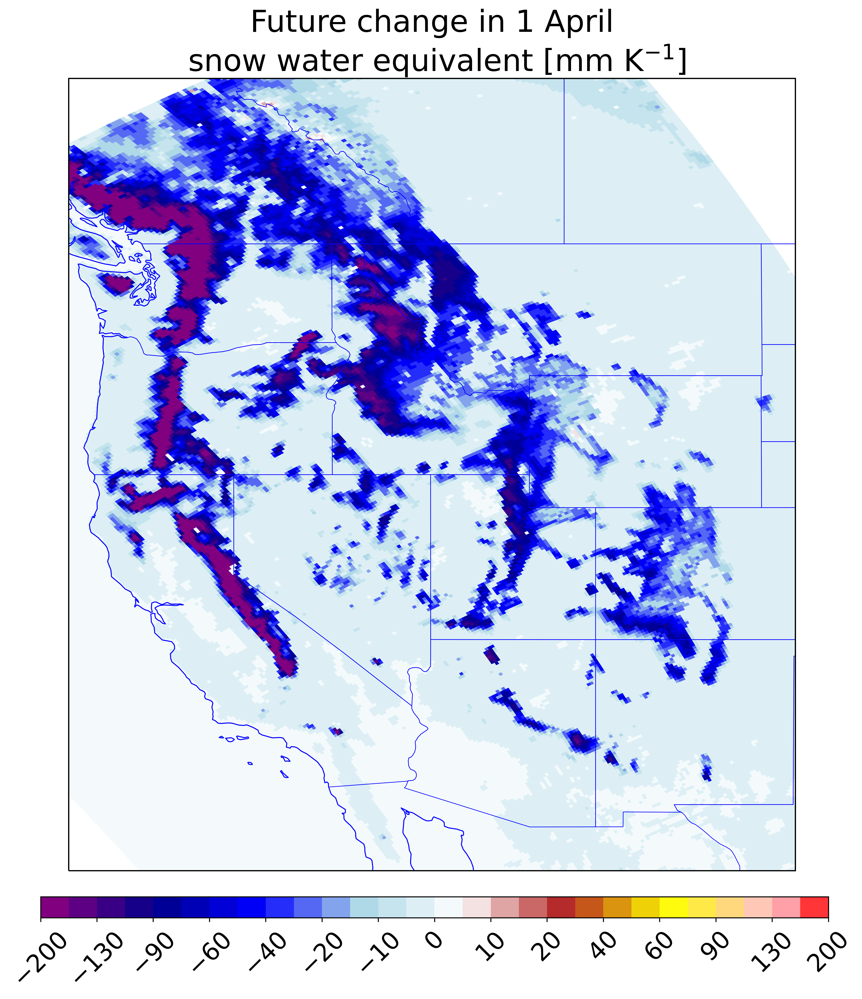

In [5]:
%%time

def _plotSingle(fignum,levs,mycmap,
                array,
                title):

    norm = matplotlib.colors.BoundaryNorm(levs,len(levs))

    colors_to_rgb = []
    for ii in mycmap:
     aa = colors.to_rgba(ii)
     colors_to_rgb.append(aa)
    cmap = LinearSegmentedColormap.from_list("t2",colors_to_rgb,len(levs)+1)

    cart_proj = crs.PlateCarree()
    axis = [-125,-103,30,54]

    fig = P.figure(fignum,figsize=(12,12),dpi=500)
    fig.patch.set_facecolor('xkcd:white')
    ax1 = P.subplot(1,1,1,projection=cart_proj)

    ax1.set_title(title,fontsize=25,loc="center")

    cs_abs = ax1.pcolormesh(array.lon,array.lat,array, \
                cmap=cmap,norm=norm)
    ax1.coastlines('50m', linewidth=0.8,color="blue")
    ax1.add_feature(states, linewidth=.5, edgecolor="blue")
    ax1.set_extent(axis)

    cbar_ax = fig.add_axes([0.14, 0.08, 0.75, 0.02]) # bottom left corner x,y, and width, height
    cb = P.colorbar(cs_abs,cax=cbar_ax,orientation="horizontal",ticks=levs[::2])
    cb.ax.tick_params(labelsize=20,rotation=45)

levs = [-200,-150,-130,-110,-90,-70,-60,-50,-40,-30,-20,-15,-10,-5,0,
        5,10,15,20,30,40,50,60,70,90,110,130,150,200]
levs = np.array(levs)
mycmap = ["purple","darkblue","blue","lightblue",
          "white",
          "firebrick","yellow","pink","red"]
title = 'Future change in 1 April\n snow water equivalent [mm K$^{-1}$]'

diff = snowApril1.sel(time=slice(2070,2100)).mean('time') - \
        snowApril1.sel(time=slice(1981,2010)).mean('time')

diff = diff / global_DeltaTemperatures.sel(month=4)
diff = diff.mean('gcm')

_plotSingle(1,levs,mycmap,
                diff,
                title)

gc.collect()

In [20]:
%%time

'''diff = 100 * (snowApril1.sel(time=slice(2070,2100)).mean('time') - \
        snowApril1.sel(time=slice(1981,2010)).mean('time') ) / \
        snowApril1.sel(time=slice(1981,2010)).mean('time')

diff = diff / global_DeltaTemperatures.sel(month=4)
diff = diff.where( snowApril1.sel(time=slice(1981,2010)).mean('time') > 10, np.nan )
diff = diff.mean('gcm')'''

gc.collect()

CPU times: user 298 ms, sys: 23.2 ms, total: 321 ms
Wall time: 317 ms


4010

/work/srahimi/clone/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: divide by zero encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/work/srahimi/clone/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: invalid value encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/work/srahimi/clone/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


CPU times: user 3min 4s, sys: 4min 22s, total: 7min 26s
Wall time: 4min 14s


7249

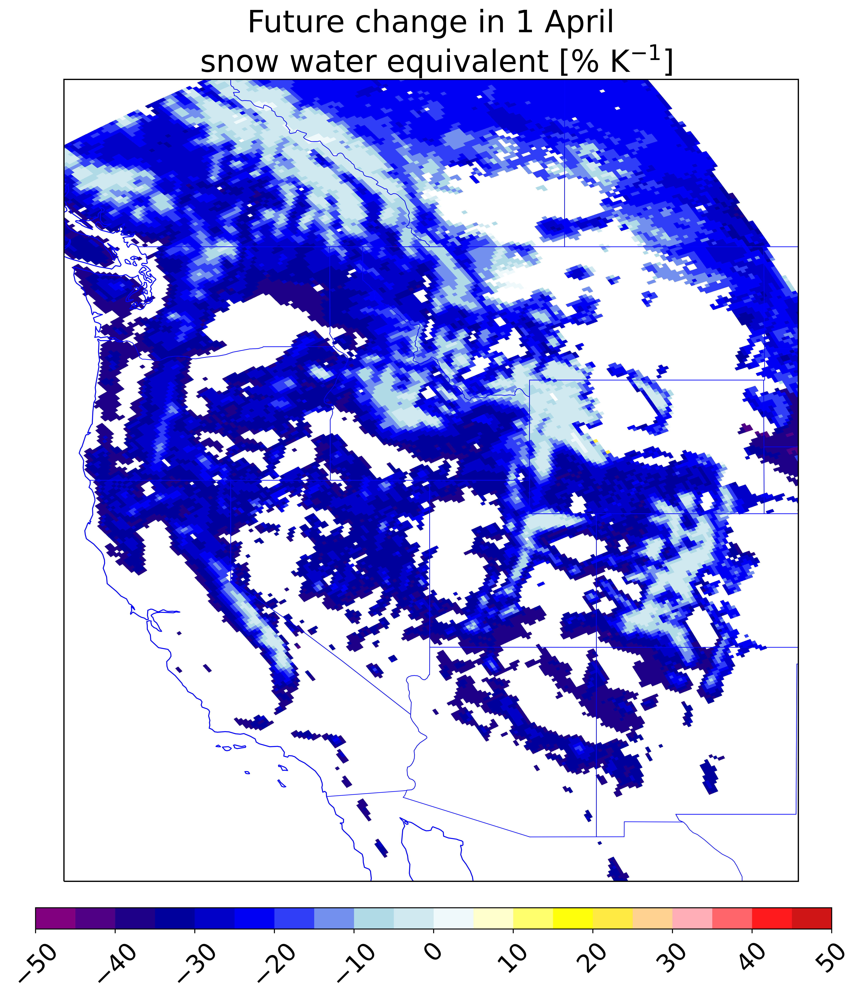

In [21]:
%%time

levs = [-130,-110,-90,-70,-60,-50,-40,-30,-20,-15,-10,-5,0,
        5,10,15,20,30,40,50,60,70,90,110,130]
levs = np.array(levs)
levs = np.arange(-50,51,5)
mycmap = ["purple","darkblue","blue","lightblue",
          "white",
          "yellow","pink","red","firebrick"]
title = 'Future change in 1 April\n snow water equivalent [$\%$ K$^{-1}$]'

diff = 100 * (snowApril1.sel(time=slice(2070,2100)).mean('time') - \
        snowApril1.sel(time=slice(1981,2010)).mean('time') ) / \
        snowApril1.sel(time=slice(1981,2010)).mean('time')

#Exclude areas where historical SWE < 10 mm 
diff = diff / global_DeltaTemperatures.sel(month=4)
diff = diff.where( snowApril1.sel(time=slice(1981,2010)).mean('time') > 10, np.nan )
diff = diff.mean('gcm')

_plotSingle(1,levs,mycmap,
                diff,
                title)

gc.collect()

CPU times: user 3min 1s, sys: 4min 16s, total: 7min 18s
Wall time: 3min 56s


12878

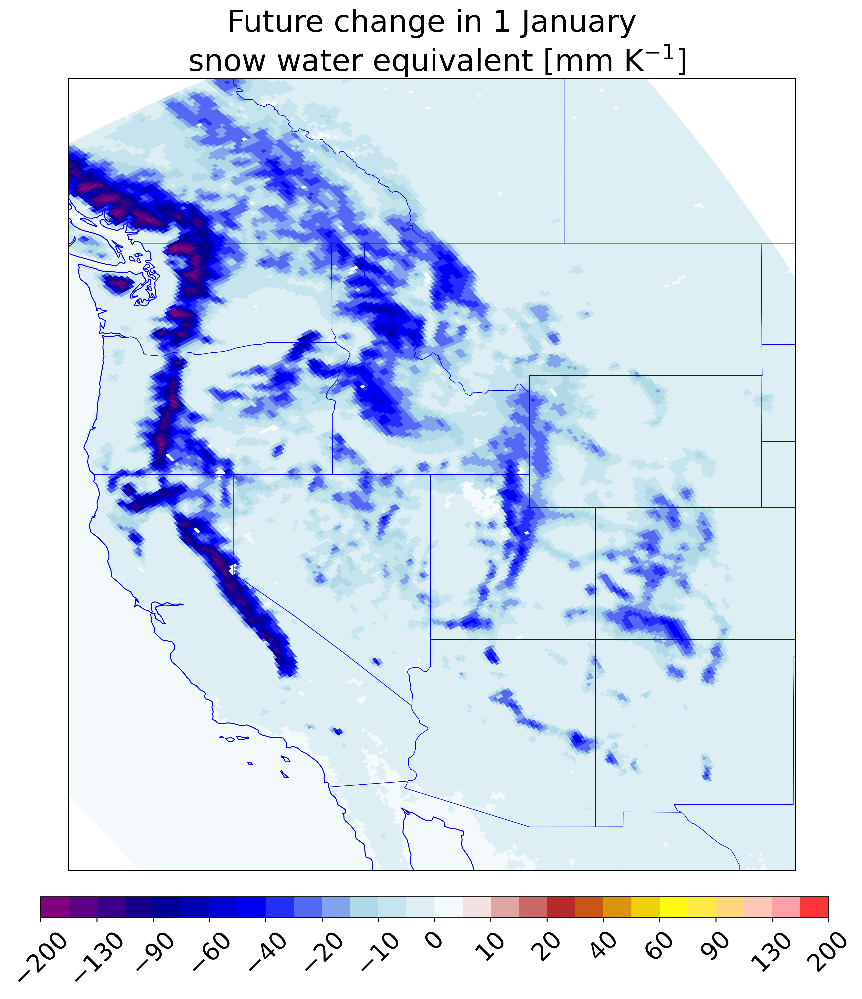

In [29]:
%%time

levs = [-200,-150,-130,-110,-90,-70,-60,-50,-40,-30,-20,-15,-10,-5,0,
        5,10,15,20,30,40,50,60,70,90,110,130,150,200]
levs = np.array(levs)
mycmap = ["purple","darkblue","blue","lightblue",
          "white",
          "firebrick","yellow","pink","red"]
title = 'Future change in 1 January\n snow water equivalent [mm K$^{-1}$]'

diff = snowJan1.sel(time=slice(2070,2100)).mean('time') - \
        snowJan1.sel(time=slice(1981,2010)).mean('time')

diff = diff / global_DeltaTemperatures.sel(month=1)
diff = diff.mean('gcm')

_plotSingle(1,levs,mycmap,
                diff,
                title)

gc.collect()

/work/srahimi/clone/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: divide by zero encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/work/srahimi/clone/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: invalid value encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/work/srahimi/clone/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


CPU times: user 3min 1s, sys: 4min 18s, total: 7min 20s
Wall time: 4min 3s


15222

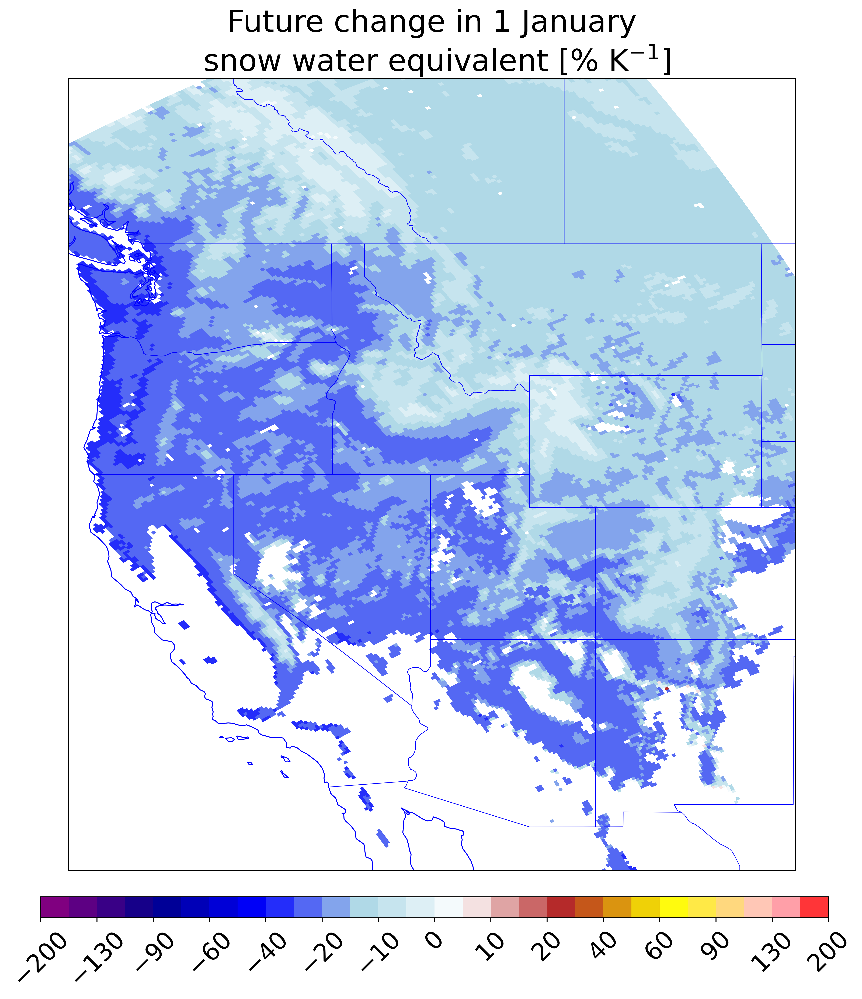

In [22]:
%%time

levs = [-200,-150,-130,-110,-90,-70,-60,-50,-40,-30,-20,-15,-10,-5,0,
        5,10,15,20,30,40,50,60,70,90,110,130,150,200]
levs = np.array(levs)
mycmap = ["purple","darkblue","blue","lightblue",
          "white",
          "firebrick","yellow","pink","red"]
title = 'Future change in 1 January\n snow water equivalent [$\%$ K$^{-1}$]'

diff = 100 * (snowJan1.sel(time=slice(2070,2100)).mean('time') - \
        snowJan1.sel(time=slice(1981,2010)).mean('time') ) / \
        snowJan1.sel(time=slice(1981,2010)).mean('time')

#Exclude areas where historical SWE < 10 mm 
diff = diff / global_DeltaTemperatures.sel(month=1)
diff = diff.where( snowJan1.sel(time=slice(1981,2010)).mean('time') > 10, np.nan )
diff = diff.mean('gcm')

_plotSingle(1,levs,mycmap,
                diff,
                title)

gc.collect()

CPU times: user 3min 2s, sys: 4min 18s, total: 7min 21s
Wall time: 4min


12878

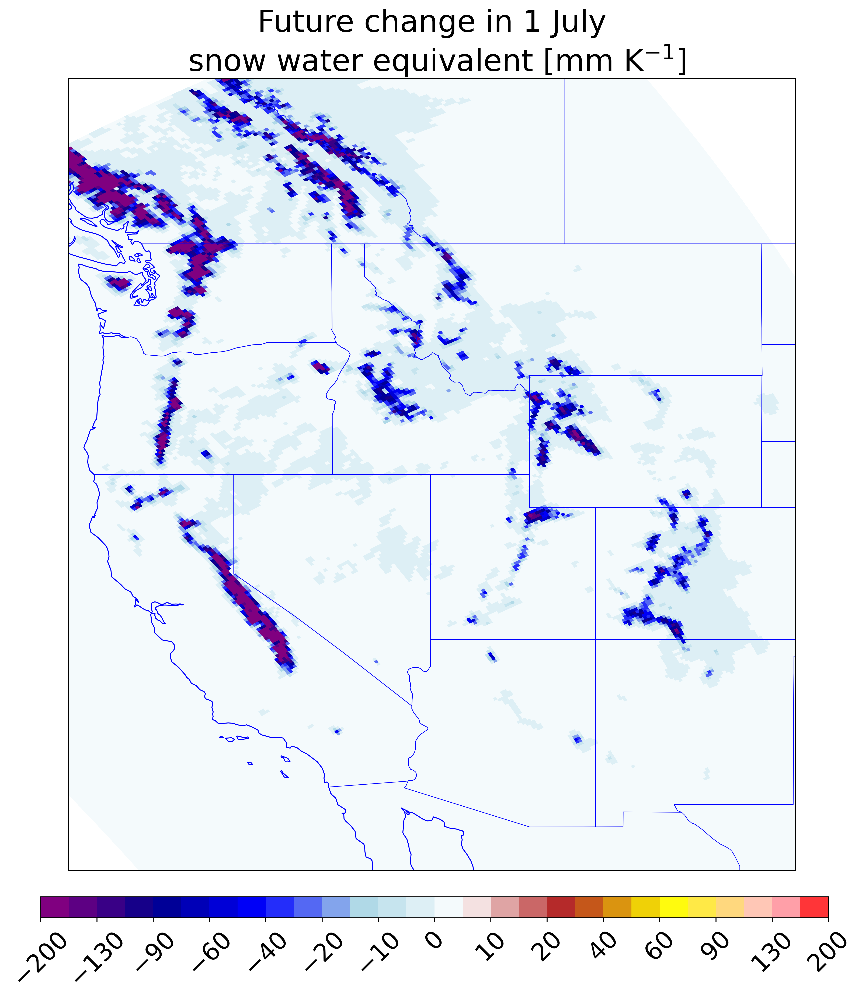

In [30]:
%%time

levs = [-200,-150,-130,-110,-90,-70,-60,-50,-40,-30,-20,-15,-10,-5,0,
        5,10,15,20,30,40,50,60,70,90,110,130,150,200]
levs = np.array(levs)
mycmap = ["purple","darkblue","blue","lightblue",
          "white",
          "firebrick","yellow","pink","red"]
title = 'Future change in 1 July\n snow water equivalent [mm K$^{-1}$]'

diff = snowJul1.sel(time=slice(2070,2100)).mean('time') - \
        snowJul1.sel(time=slice(1981,2010)).mean('time')

diff = diff / global_DeltaTemperatures.sel(month=7)
diff = diff.mean('gcm')

_plotSingle(1,levs,mycmap,
                diff,
                title)

gc.collect()

/work/srahimi/clone/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: divide by zero encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/work/srahimi/clone/lib/python3.7/site-packages/dask/core.py:121: RuntimeWarning: invalid value encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/work/srahimi/clone/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


CPU times: user 3min 4s, sys: 4min 18s, total: 7min 22s
Wall time: 4min 23s


15518

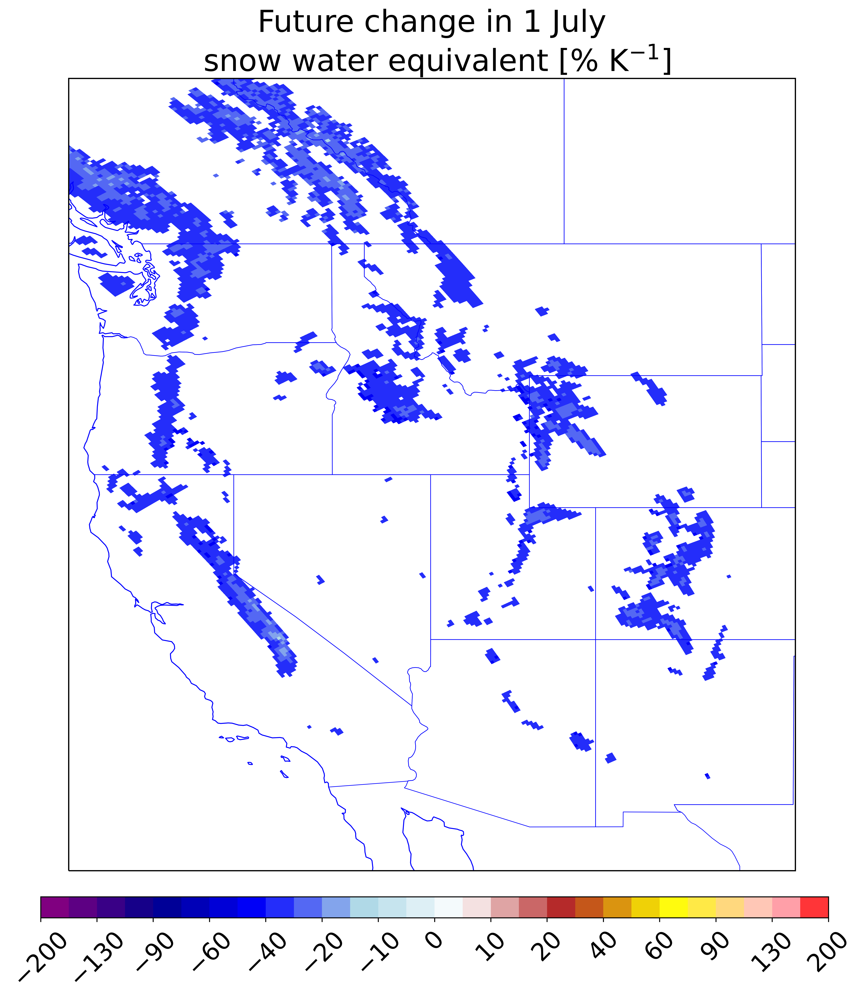

In [24]:
%%time

levs = [-200,-150,-130,-110,-90,-70,-60,-50,-40,-30,-20,-15,-10,-5,0,
        5,10,15,20,30,40,50,60,70,90,110,130,150,200]
levs = np.array(levs)
mycmap = ["purple","darkblue","blue","lightblue",
          "white",
          "firebrick","yellow","pink","red"]
title = 'Future change in 1 July\n snow water equivalent [$\%$ K$^{-1}$]'

diff = 100 * (snowJul1.sel(time=slice(2070,2100)).mean('time') - \
        snowJul1.sel(time=slice(1981,2010)).mean('time') ) / \
        snowJul1.sel(time=slice(1981,2010)).mean('time')

#Exclude areas where historical SWE < 10 mm 
diff = diff / global_DeltaTemperatures.sel(month=7)
diff = diff.where( snowJul1.sel(time=slice(1981,2010)).mean('time') > 10, np.nan )
diff = diff.mean('gcm')

_plotSingle(1,levs,mycmap,
                diff,
                title)

gc.collect()

# SNOTEL time series

In [25]:
%%time

def _plotTimeSeriesEnsembleFuture(fignum,period,region,var_name,domain,var,legend,axis):
    
    data = xr.open_dataset("../hello_world_paper/files/%s_snotel_ts_day_%s.nc" %(var,region))
    units = data.units.split(" ")
    num_sites = units[3].split("-")
    num_sites = num_sites[0]

    fig = P.figure(fignum,figsize=(10,10))
    fig.patch.set_facecolor('xkcd:white')
    
    prefixes = ['cesm2','mpi-esm1-2-lr',
                'cnrm-esm2-1','ec-earth3-veg',
                'fgoals-g3','ukesm1-0-ll',
                'canesm5','access-cm2',
                'ec-earth3']
    
    variants = ['r11i1p1f1','r7i1p1f1',
                'r1i1p1f2','r1i1p1f1',
                'r1i1p1f1','r2i1p1f2',
                'r1i1p2f1','r5i1p1f1',
                'r1i1p1f1']
    
    ssps = ['ssp370','ssp370',
                'ssp370','ssp370',
                'ssp370','ssp370',
                'ssp370','ssp370',
                'ssp370']
    
    bc = []
    no_bc = []

    for icount in range(0,len(prefixes)):
    
        model = prefixes[icount]
        variant = variants[icount]
        ssp = ssps[icount]
        
        bc_x_historical = xr.open_dataset("../hello_world_paper/files/%s_wrfPD_ts_day.%s_hist_BIAS_CORRECT_%s_%s_%s.nc" %(var,model,variant,domain,region))
        no_bc_x_historical = xr.open_dataset("../hello_world_paper/files/%s_wrfPD_ts_day.%s_hist_%s_%s_%s.nc" %(var,model,variant,domain,region))

        bc_x_future = xr.open_dataset("../hello_world_paper/files/%s_wrf%s_ts_day.%s_%s_BIAS_CORRECT_%s_%s_%s.nc" %(var,period,model,ssp,variant,domain,region))
        no_bc_x_future = xr.open_dataset("../hello_world_paper/files/%s_wrf%s_ts_day.%s_%s_%s_%s_%s.nc" %(var,period,model,ssp,variant,domain,region))
        
        #Only consider the first 360 elements
        bc_x_historical = xr.DataArray(bc_x_historical.daily.values[:360],dims=['dayofyear'])
        no_bc_x_historical = xr.DataArray(no_bc_x_historical.daily.values[:360],dims=['dayofyear'])
        bc_x_historical = bc_x_historical.expand_dims('gcm')
        no_bc_x_historical = no_bc_x_historical.expand_dims('gcm')
        
        bc_x_future = xr.DataArray(bc_x_future.daily.values[:360],dims=['dayofyear'])
        no_bc_x_future = xr.DataArray(no_bc_x_future.daily.values[:360],dims=['dayofyear'])
        bc_x_future = bc_x_future.expand_dims('gcm')
        no_bc_x_future = no_bc_x_future.expand_dims('gcm')
        
        bc.append(bc_x_future - bc_x_historical)
        no_bc.append(no_bc_x_future - no_bc_x_historical)

    bc = xr.concat(bc,dim='gcm')
    no_bc = xr.concat(no_bc,dim='gcm')
    bc['gcm'] = prefixes
    no_bc['gcm'] = prefixes
    
    x = np.arange(0,len(no_bc.dayofyear))

    P.plot(x,bc.mean(dim='gcm'),color='red',linewidth=3,linestyle="-",label='w/ BC',zorder=2)
    P.fill_between(x, bc.min(dim='gcm'), bc.max(dim='gcm'),
                  alpha=0.25,color='red',zorder=0)
    
    P.plot(x,no_bc.mean(dim='gcm'),color='blue',linewidth=3,linestyle="-",label='w/o BC',zorder=3)
    P.fill_between(x, no_bc.min(dim='gcm'), no_bc.max(dim='gcm'),
                  alpha=0.25,color='blue',zorder=0)  
    
    P.plot([-10000,10000],[0,0],color='k',linewidth=0.5)

    P.axis(axis)

    ax = P.gca()
    ax.set_aspect(1.0/ax.get_data_ratio(), adjustable='box')

    ax.set_title("%s \n at %s %s sites" %(var_name,num_sites,region), \
                 fontsize=20,weight='bold')
    
    ax.set_ylabel("[mm]",fontsize=25)
    ax.set_xlabel("Day",fontsize=25)
    P.yticks(fontsize=20)
    
    if legend == True:
        legend = P.legend(ncol=1,loc='lower left')
        for label in legend.get_texts():
                 label.set_fontsize(22)
            
    x_strings = ["" for i in range(12)]
    x_strings[0] = "1 Sep"
    x_strings[1] = "1 Oct"
    x_strings[2] = "1 Nov"
    x_strings[3] = "1 Dec"
    x_strings[4] = "1 Jan"
    x_strings[5] = "1 Feb"
    x_strings[6] = "1 Mar"
    x_strings[7] = "1 Apr"
    x_strings[8] = "1 May"
    x_strings[9] = "1 Jun"
    x_strings[10] = "1 Jul"
    x_strings[11] = "1 Aug"

    x = np.arange(0,360,1)
    P.xticks(x,x_strings,fontsize=20,rotation=45)
    P.locator_params(axis='x', nbins=12)

    ax = P.gca()
    ax.fill_betweenx([-10000,10000], 0, 92,color='gray',alpha=0.4,zorder=0,
                    )
    
    ax.fill_betweenx([-10000,10000], 185, 278,color='gray',alpha=0.4,zorder=0,
                    )
    
    P.grid(b=True, which='both', color='0.65', linestyle='-')

    
gc.collect()

CPU times: user 321 ms, sys: 26.8 ms, total: 348 ms
Wall time: 343 ms


4222

CPU times: user 3.7 s, sys: 146 ms, total: 3.85 s
Wall time: 5.29 s


505

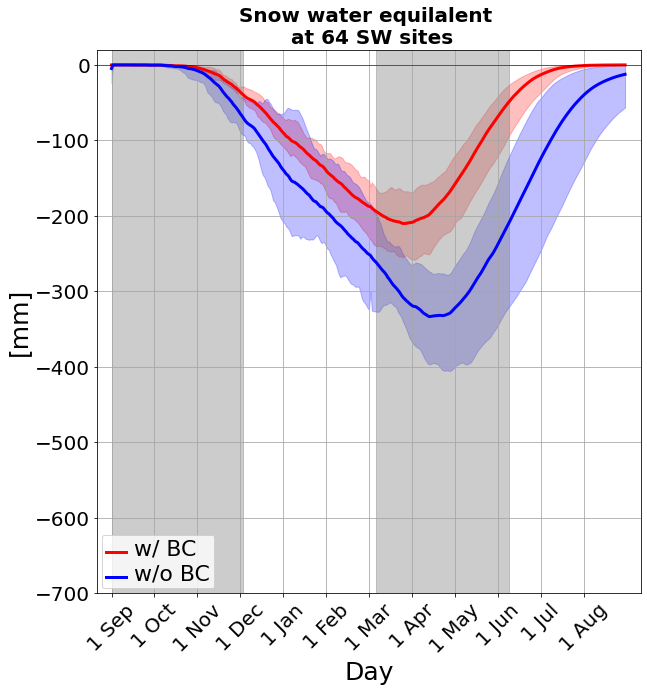

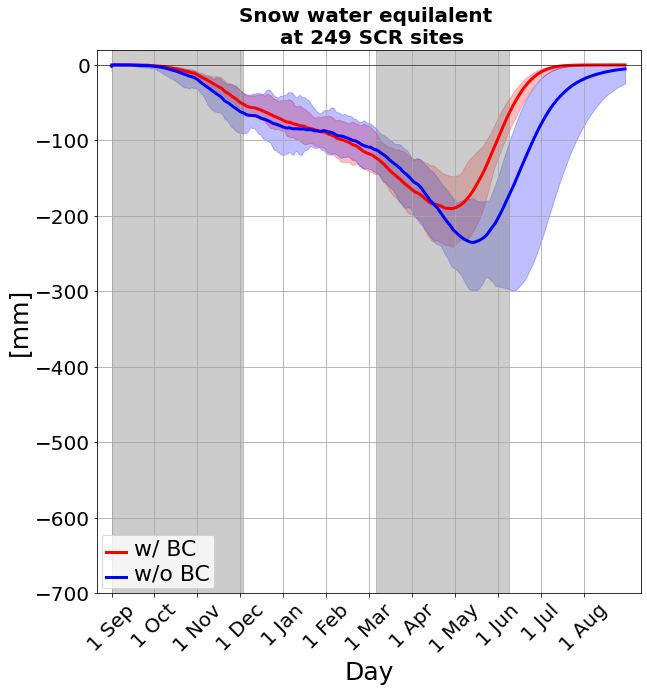

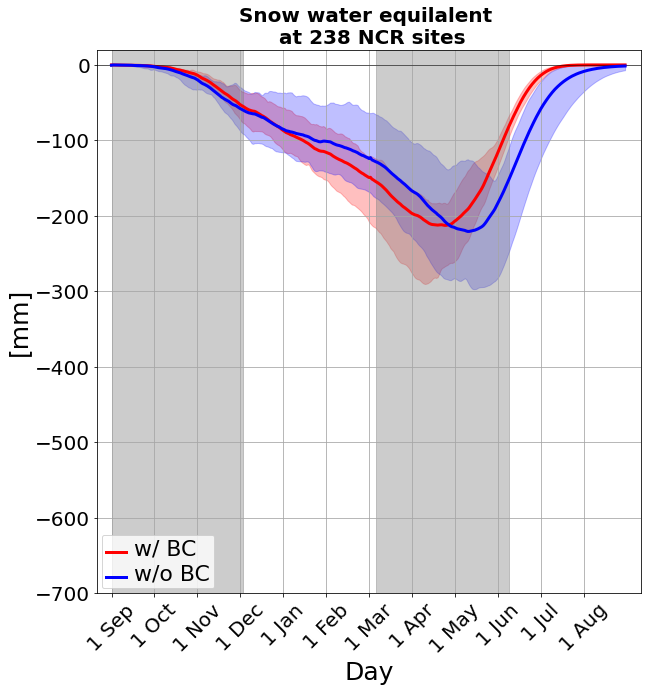

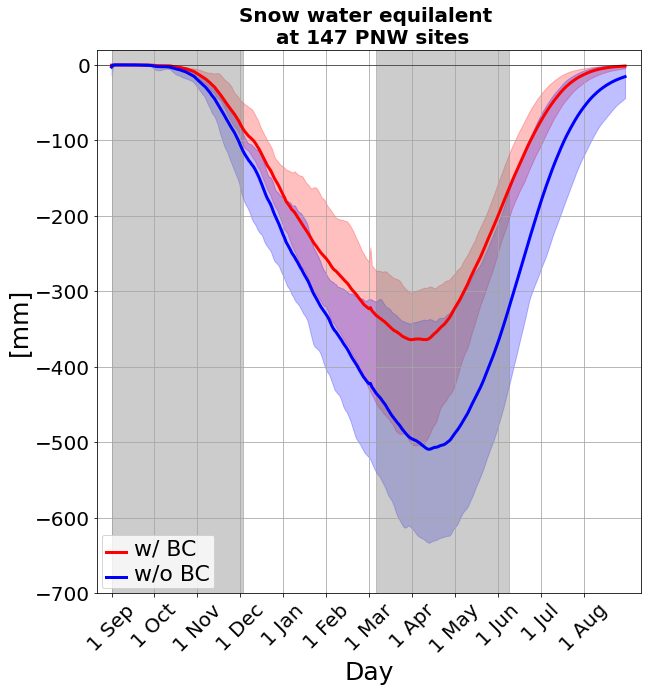

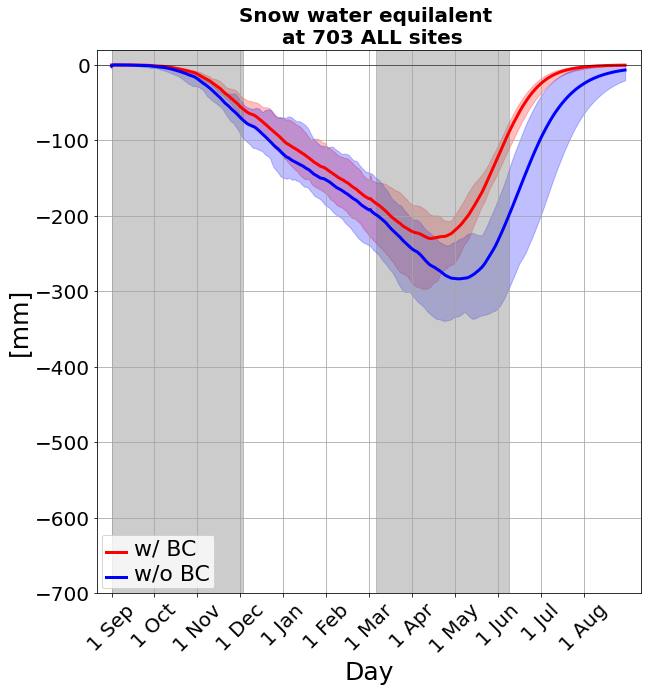

In [26]:
%%time

regional_acronym = ["SW","SCR","NCR","PNW","ALL"]

domain = "d02"
var = "snow"
legend = True
axis = [-10,370,-700,20]
var_name = "Snow water equilalent"
period ='EC'

for count, iregion in enumerate(regional_acronym):
    _plotTimeSeriesEnsembleFuture(count+1,period,iregion,var_name,domain,var,legend,axis)
    #break
    
gc.collect()

# GCM temperature change signal from monthly to daily

In [59]:
%%time

data = global_DeltaTemperatures

iyear = 1980

months = []
for imonth in range(0,12):
    months.append("%s-%s-15" %(iyear,imonth+1) )

months_considered = months
months_considered = pd.to_datetime(months_considered, format='%Y-%m-%d')

data['month'] = months_considered

months.insert(0,"%s-12-15" %(int(iyear)-1) )
months.append("%s-01-15" %(int(iyear)+1) )

months_of_data = pd.to_datetime(months, format='%Y-%m-%d')

data_before = data.isel(month=11).expand_dims("month")
data_after = data.isel(month=1).expand_dims("month")

expand_data = xr.concat([data_before,data,data_after],dim="month")
expand_data['month'] = months_of_data

global_DeltaTemperaturesDaily = expand_data.resample(month='1D').interpolate("linear")
global_DeltaTemperaturesDaily = global_DeltaTemperaturesDaily.sel(month=slice("%s-01-01" %(iyear),"%s-12-31" %(iyear)))
global_DeltaTemperaturesDaily = global_DeltaTemperaturesDaily.rename({'month': 'time'})

global_DeltaTemperaturesDaily = global_DeltaTemperaturesDaily.roll(time=roll,roll_coords=True)
print (global_DeltaTemperaturesDaily)

gc.collect()


<xarray.DataArray 'tas' (time: 366, gcm: 16)>
array([[3.2783144 , 2.48404478, 3.41547218, ..., 2.70842887, 2.55157154,
        4.51508257],
       [3.27510574, 2.48413907, 3.41489395, ..., 2.71040212, 2.55118319,
        4.5101637 ],
       [3.27189707, 2.48423336, 3.41431573, ..., 2.71237536, 2.55079485,
        4.50524484],
       ...,
       [3.2879404 , 2.48376189, 3.41720687, ..., 2.70250913, 2.55273657,
        4.52983917],
       [3.28473173, 2.48385619, 3.41662864, ..., 2.70448238, 2.55234823,
        4.5249203 ],
       [3.28152307, 2.48395048, 3.41605041, ..., 2.70645563, 2.55195988,
        4.52000144]])
Coordinates:
    height   int64 2
  * gcm      (gcm) <U29 'cesm2_r11i1p1f1_ssp370' ... 'cesm2_r11i1p1f1_ssp585'
  * time     (time) datetime64[ns] 1980-09-01 1980-09-02 ... 1980-08-31
CPU times: user 312 ms, sys: 9.85 ms, total: 322 ms
Wall time: 316 ms


0

In [87]:
%%time

def _plotTimeSeriesEnsembleFutureDeltaT(fignum,period,region,var_name,domain,var,legend,axis,
                                       delta_t):
    
    data = xr.open_dataset("../hello_world_paper/files/%s_snotel_ts_day_%s.nc" %(var,region))
    units = data.units.split(" ")
    num_sites = units[3].split("-")
    num_sites = num_sites[0]

    fig = P.figure(fignum,figsize=(10,10))
    fig.patch.set_facecolor('xkcd:white')
    
    prefixes = ['cesm2','mpi-esm1-2-lr',
                'cnrm-esm2-1','ec-earth3-veg',
                'fgoals-g3','ukesm1-0-ll',
                'canesm5','access-cm2',
                'ec-earth3']
    
    variants = ['r11i1p1f1','r7i1p1f1',
                'r1i1p1f2','r1i1p1f1',
                'r1i1p1f1','r2i1p1f2',
                'r1i1p2f1','r5i1p1f1',
                'r1i1p1f1']
    
    ssps = ['ssp370','ssp370',
                'ssp370','ssp370',
                'ssp370','ssp370',
                'ssp370','ssp370',
                'ssp370']
    
    bc = []
    no_bc = []

    for icount in range(0,len(prefixes)):
    
        gcm = '%s_%s_%s' %(prefixes[icount],variants[icount],
                           ssps[icount])
        #print (gcm)
    
        model = prefixes[icount]
        variant = variants[icount]
        ssp = ssps[icount]
        
        bc_x_historical = xr.open_dataset("../hello_world_paper/files/%s_wrfPD_ts_day.%s_hist_BIAS_CORRECT_%s_%s_%s.nc" %(var,model,variant,domain,region))
        no_bc_x_historical = xr.open_dataset("../hello_world_paper/files/%s_wrfPD_ts_day.%s_hist_%s_%s_%s.nc" %(var,model,variant,domain,region))

        bc_x_future = xr.open_dataset("../hello_world_paper/files/%s_wrf%s_ts_day.%s_%s_BIAS_CORRECT_%s_%s_%s.nc" %(var,period,model,ssp,variant,domain,region))
        no_bc_x_future = xr.open_dataset("../hello_world_paper/files/%s_wrf%s_ts_day.%s_%s_%s_%s_%s.nc" %(var,period,model,ssp,variant,domain,region))
        
        #Only consider the first 360 elements
        bc_x_historical = xr.DataArray(bc_x_historical.daily.values[:360],dims=['dayofyear'])
        no_bc_x_historical = xr.DataArray(no_bc_x_historical.daily.values[:360],dims=['dayofyear'])
        bc_x_historical = bc_x_historical.expand_dims('gcm')
        no_bc_x_historical = no_bc_x_historical.expand_dims('gcm')
        
        bc_x_future = xr.DataArray(bc_x_future.daily.values[:360],dims=['dayofyear'])
        no_bc_x_future = xr.DataArray(no_bc_x_future.daily.values[:360],dims=['dayofyear'])
        bc_x_future = bc_x_future.expand_dims('gcm')
        no_bc_x_future = no_bc_x_future.expand_dims('gcm')
        
        bc.append( 100* (bc_x_future - bc_x_historical) / bc_x_historical )
        no_bc.append(100 * (no_bc_x_future - no_bc_x_historical) / no_bc_x_historical )

    bc = xr.concat(bc,dim='gcm')
    no_bc = xr.concat(no_bc,dim='gcm')
    bc['gcm'] = prefixes
    no_bc['gcm'] = prefixes
    
    x = np.arange(0,len(no_bc.dayofyear))

    bc = bc / delta_t.isel(time=slice(0,360),gcm=slice(0,9)).transpose('gcm','time').values
    P.plot(x,bc.mean('gcm'),color='red',linewidth=3,linestyle="-",label='w/ BC',zorder=2)
    
    no_bc = no_bc / delta_t.isel(time=slice(0,360),gcm=slice(0,9)).transpose('gcm','time').values    
    P.plot(x,no_bc.mean(dim='gcm'),color='blue',linewidth=3,linestyle="-",label='w/o BC',zorder=3)
 
    
    P.plot([-10000,10000],[0,0],color='k',linewidth=0.5)

    P.axis(axis)

    ax = P.gca()
    ax.set_aspect(1.0/ax.get_data_ratio(), adjustable='box')

    ax.set_title("%s \n at %s %s sites" %(var_name,num_sites,region), \
                 fontsize=20,weight='bold')
    
    ax.set_ylabel("[$\%$]",fontsize=25)
    ax.set_xlabel("Day",fontsize=25)
    P.yticks(fontsize=20)
    
    if legend == True:
        legend = P.legend(ncol=1,loc='lower left')
        for label in legend.get_texts():
                 label.set_fontsize(22)
            
    x_strings = ["" for i in range(12)]
    x_strings[0] = "1 Sep"
    x_strings[1] = "1 Oct"
    x_strings[2] = "1 Nov"
    x_strings[3] = "1 Dec"
    x_strings[4] = "1 Jan"
    x_strings[5] = "1 Feb"
    x_strings[6] = "1 Mar"
    x_strings[7] = "1 Apr"
    x_strings[8] = "1 May"
    x_strings[9] = "1 Jun"
    x_strings[10] = "1 Jul"
    x_strings[11] = "1 Aug"

    x = np.arange(0,360,1)
    P.xticks(x,x_strings,fontsize=20,rotation=45)
    P.locator_params(axis='x', nbins=12)

    ax = P.gca()
    ax.fill_betweenx([-10000,10000], 0, 92,color='gray',alpha=0.4,zorder=0,
                    )
    
    ax.fill_betweenx([-10000,10000], 185, 278,color='gray',alpha=0.4,zorder=0,
                    )
    
    P.grid(b=True, which='both', color='0.65', linestyle='-')

    
gc.collect()

CPU times: user 394 ms, sys: 4.09 ms, total: 398 ms
Wall time: 393 ms


103235

CPU times: user 3.22 s, sys: 63.1 ms, total: 3.28 s
Wall time: 3.4 s


325

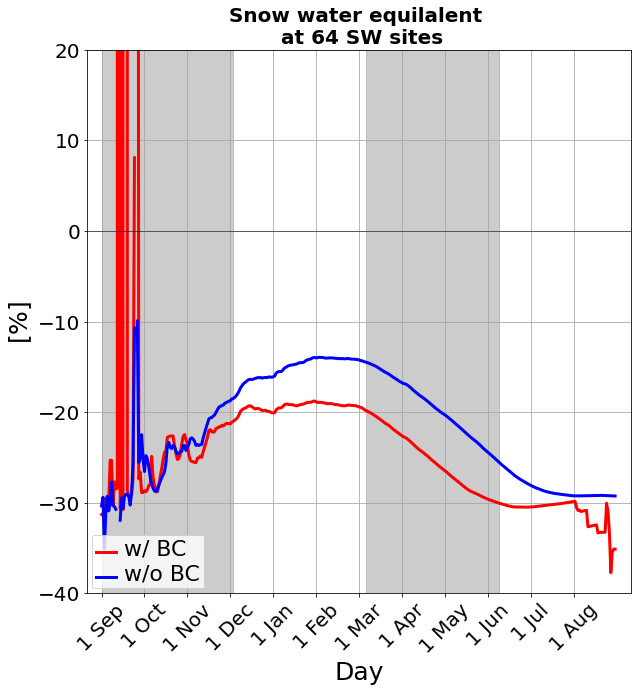

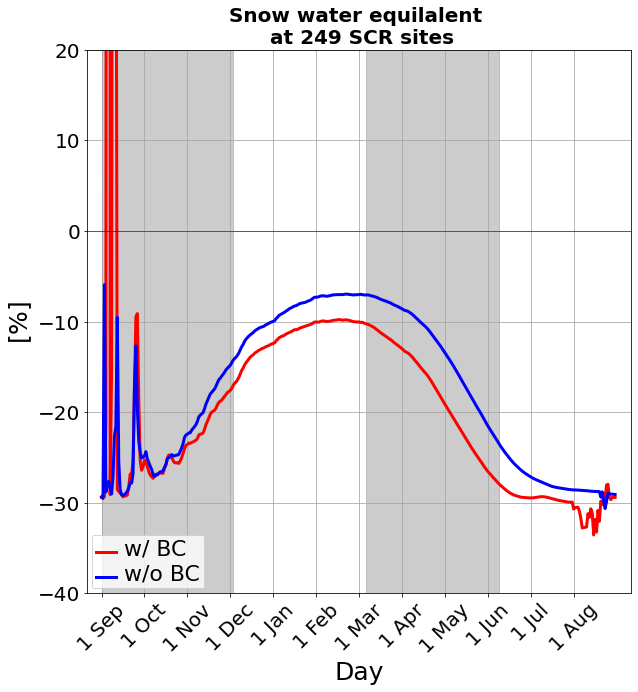

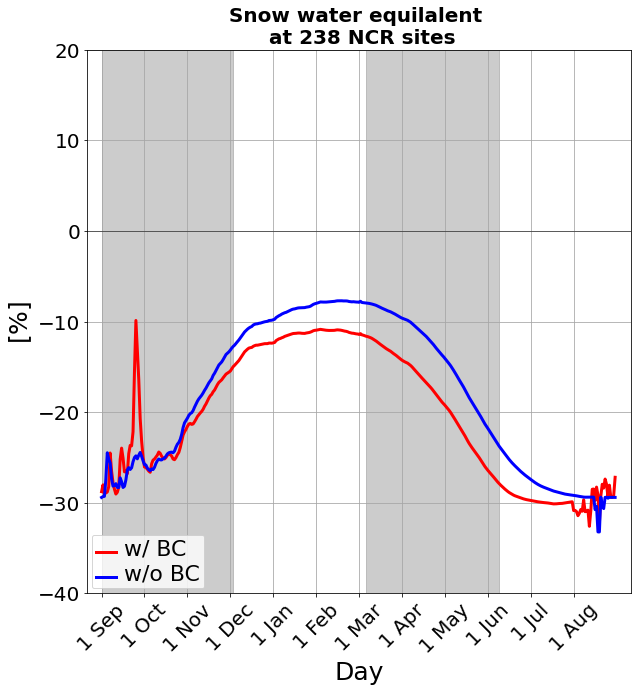

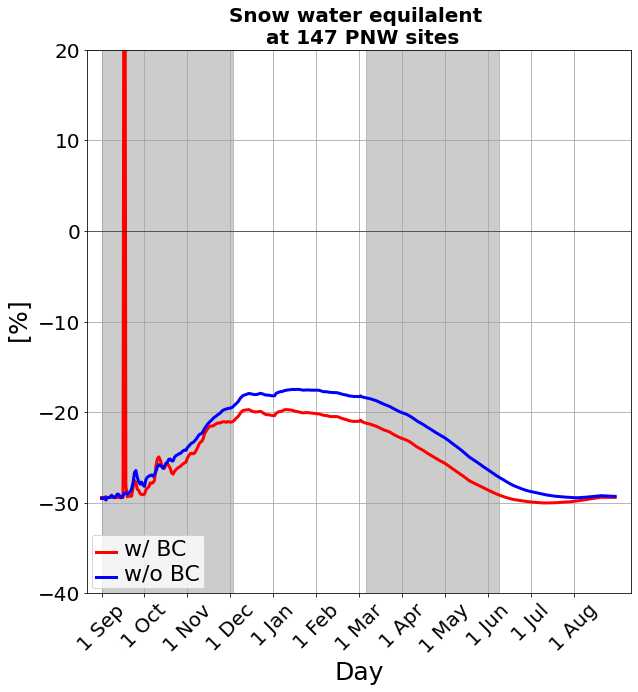

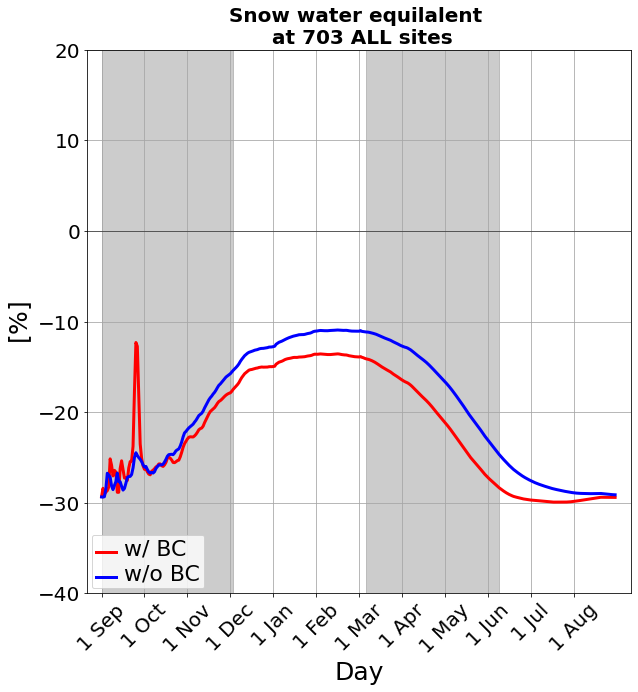

In [88]:
%%time

domain = "d02"
var = "snow"
legend = True
axis = [-10,370,-40,20]
var_name = "Snow water equilalent"
period ='EC'

for count, iregion in enumerate(regional_acronym):
    _plotTimeSeriesEnsembleFutureDeltaT(count+1,period,iregion,var_name,domain,var,legend,axis,
                                       global_DeltaTemperaturesDaily)
    #break

gc.collect()

# Consider time progression of SWE at SNOTEL sites

In [93]:
%%time

snow_SNOTELfromWRF = []

var = 'snow'
data = xr.open_dataset("./files/site_indices_%s_%s_%s.nc" %(var,domain,'ALL'))
iii, jjj = data.ii_dim.values, data.jj_dim.values

for icount, igcm in enumerate(snow_noBC.keys()):

    #Valid on the first of each month for each site
    snow_x = snow_noBC[igcm].isel(lat2d=xr.DataArray(jjj,dims="site"), lon2d=xr.DataArray(iii,dims="site"))
    snow = snow_x.sel(time=(snow_x.time.dt.day == 1)
                       ).load()
    
    if icount == 0:
        times = snow.time
        
    if icount != 0:
        snow['time'] = times
        
    snow_SNOTELfromWRF.append(snow)
    print (igcm)
    
snow_SNOTELfromWRF_noBC = xr.concat(snow_SNOTELfromWRF,dim='gcm')
snow_SNOTELfromWRF_noBC['gcm'] = keys

zSNOTEL = z_wrf.isel(lat2d=xr.DataArray(jjj,dims="site"), lon2d=xr.DataArray(iii,dims="site")).load()
z_coords = {'zWRF': (['site'],  zSNOTEL)}
snow_SNOTELfromWRF_noBC = snow_SNOTELfromWRF_noBC.assign_coords(z_coords)

print (snow_SNOTELfromWRF_noBC)

gc.collect()

cesm2_r11i1p1f1_ssp370
mpi-esm1-2-lr_r7i1p1f1_ssp370
cnrm-esm2-1_r1i1p1f2_ssp370
ec-earth3-veg_r1i1p1f1_ssp370
fgoals-g3_r1i1p1f1_ssp370
ukesm1-0-ll_r2i1p1f2_ssp370
canesm5_r1i1p2f1_ssp370
access-cm2_r5i1p1f1_ssp370
ec-earth3_r1i1p1f1_ssp370
miroc6_r1i1p1f1_ssp370
noresm2-mm_r1i1p1f1_ssp370
mpi-esm1-2-hr_r7i1p1f1_ssp370
taiesm1_r1i1p1f1_ssp370
giss-e2-1-g_r1i1p1f2_ssp370
cesm2_r11i1p1f1_ssp245
cesm2_r11i1p1f1_ssp585
<xarray.DataArray (gcm: 16, time: 1440, site: 703)>
array([[[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 1.31723165e-04, 1.28184870e-01],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 3.18175741e-02],
        ...,
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 0.00000000

23851

In [94]:
%%time

snow_SNOTELfromWRF = []

var = 'snow'
data = xr.open_dataset("./files/site_indices_%s_%s_%s.nc" %(var,domain,'ALL'))
iii, jjj = data.ii_dim.values, data.jj_dim.values

for icount, igcm in enumerate(snow_BC.keys()):

    #Valid on the first of each month for each site
    snow_x = snow_BC[igcm].isel(lat2d=xr.DataArray(jjj,dims="site"), lon2d=xr.DataArray(iii,dims="site"))
    snow = snow_x.sel(time=(snow_x.time.dt.day == 1)
                       ).load()
    
    if icount == 0:
        times = snow.time
        
    if icount != 0:
        snow['time'] = times
        
    snow_SNOTELfromWRF.append(snow)
    print (igcm)
    
snow_SNOTELfromWRF_BC = xr.concat(snow_SNOTELfromWRF,dim='gcm')
snow_SNOTELfromWRF_BC['gcm'] = keys[0:9]

zSNOTEL = z_wrf.isel(lat2d=xr.DataArray(jjj,dims="site"), lon2d=xr.DataArray(iii,dims="site")).load()
z_coords = {'zWRF': (['site'],  zSNOTEL)}
snow_SNOTELfromWRF_BC = snow_SNOTELfromWRF_BC.assign_coords(z_coords)

print (snow_SNOTELfromWRF_BC)

gc.collect()

cesm2_r11i1p1f1_ssp370
mpi-esm1-2-lr_r7i1p1f1_ssp370
cnrm-esm2-1_r1i1p1f2_ssp370
ec-earth3-veg_r1i1p1f1_ssp370
fgoals-g3_r1i1p1f1_ssp370
ukesm1-0-ll_r2i1p1f2_ssp370
canesm5_r1i1p2f1_ssp370
access-cm2_r5i1p1f1_ssp370
ec-earth3_r1i1p1f1_ssp370
<xarray.DataArray (gcm: 9, time: 1440, site: 703)>
array([[[0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 2.1567168e+00, 5.3938568e-01],
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        ...,
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00]],

       [

14051

In [58]:
%%time

print (snow_SNOTELfromWRF_BC.zWRF.min().values)
print (snow_SNOTELfromWRF_BC.zWRF.max().values)

gc.collect()

154.79608
3649.4312
CPU times: user 355 ms, sys: 6.43 ms, total: 362 ms
Wall time: 359 ms


20

In [96]:
%%time

domain = 'd02'
prefix = 'era5'
dir_x = "/data/modelOutput/WRF_2020"

var = 'snow'
calendar = 'proleptic_gregorian'
dir = dir_x + "/era5/postprocess/" + domain + "/"
snow_x = _wrfread(prefix,dir,var,domain,calendar).assign_coords(coords)
snow_x = snow_x.isel(lat2d=xr.DataArray(jjj,dims="site"), lon2d=xr.DataArray(iii,dims="site"))

snow = snow_x.sel(time=(snow_x.time.dt.day == 1)
                    ).load()
snow_SNOTELfromWRF_ERA5 = snow.assign_coords(z_coords)
print (snow_SNOTELfromWRF_ERA5)
gc.collect()

1950 9 1
2021 8 31
<xarray.DataArray (time: 852, site: 703)>
array([[0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        2.0934126],
       [0.       , 0.       , 0.       , ..., 2.1554477, 0.       ,
        0.       ],
       ...,
       [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ]], dtype=float32)
Coordinates:
  * time     (time) object 1950-09-01 00:00:00 ... 2021-08-01 00:00:00
    lat      (site) float32 36.34 35.27 35.25 35.1 ... 41.04 42.7 41.38 44.37
    lon      (site) float32 -109.1 -112.1 -111.7 -111.8 ... -109.4 -107.2 -107.0
    zWRF     (site) float32 2.49e+03 2.16e+03 2.375e+03 ... 2.389e+03 2.6e+03
Dimensions without coordinates: site
Attributes:
    average_o

0

# Transient warming time series

In [216]:
def _plotTimeSeries(fignum,
                    bc,nobc,era5,
                    title,
                   bc_p,nobc_p,percentiles):
    
    P.figure(fignum,figsize=(7,5),dpi=300)
    P.title(title,fontsize=20)
    
    x = np.arange(1981,1981+len(bc.time))

    #Bias corrected
    #Regressions
    m = scipy.stats.linregress(x, bc.mean('gcm')).slope
    m = np.round(m*100,2)
    label = 'w/BC: %s' %(m)
    P.plot(x,bc.mean('gcm'),color='red',linewidth=1.5,linestyle="-",label=label,zorder=2)
    P.fill_between(x, bc.min('gcm'), bc.max('gcm'),
                  alpha=0.25,color='red',zorder=0)
    
    x = np.arange(1981,1981+len(nobc.time))

    #Non-bias corrected
    #Regressions
    m = scipy.stats.linregress(x, nobc.mean('gcm')).slope
    m = np.round(m*100,2)
    label = 'no BC: %s' %(m)
    P.plot(x,nobc.mean('gcm'),color='blue',linewidth=1.5,linestyle="-",label=label,zorder=2)
    P.fill_between(x, nobc.min('gcm'), nobc.max('gcm'),
                  alpha=0.25,color='blue',zorder=0)
    
    x = np.arange(1981,1981+len(era5.time))

    #Non-bias corrected
    P.plot(x,era5,color='k',linewidth=1.5,linestyle="--",label='ERA5',zorder=3)    
    
    if percentiles:
        for ii in bc_p[:-1]:
            P.plot([2050,2100],[ii.values,ii.values],color='red',linewidth=0.5)
        for ii in nobc_p[:-1]:
            P.plot([2050,2100],[ii.values,ii.values],color='blue',linewidth=0.5)
    
    ii = bc_p.sel(quantile=0.5)
    P.plot([1981,2100],[ii.values,ii.values],color='red',linewidth=1)
    ii = nobc_p.sel(quantile=0.5)
    P.plot([1981,2100],[ii.values,ii.values],color='blue',linewidth=1)
    
    P.legend(loc='upper right',fontsize=15)
    
gc.collect()  

20096

/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfun

CPU times: user 2.12 s, sys: 697 ms, total: 2.82 s
Wall time: 2.84 s


15

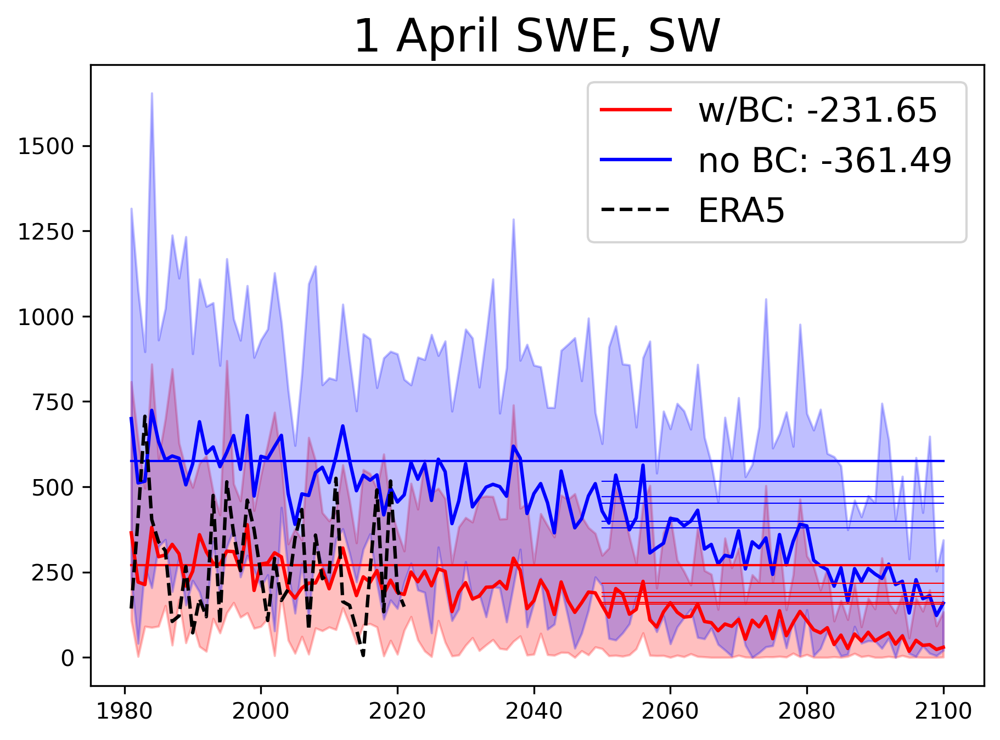

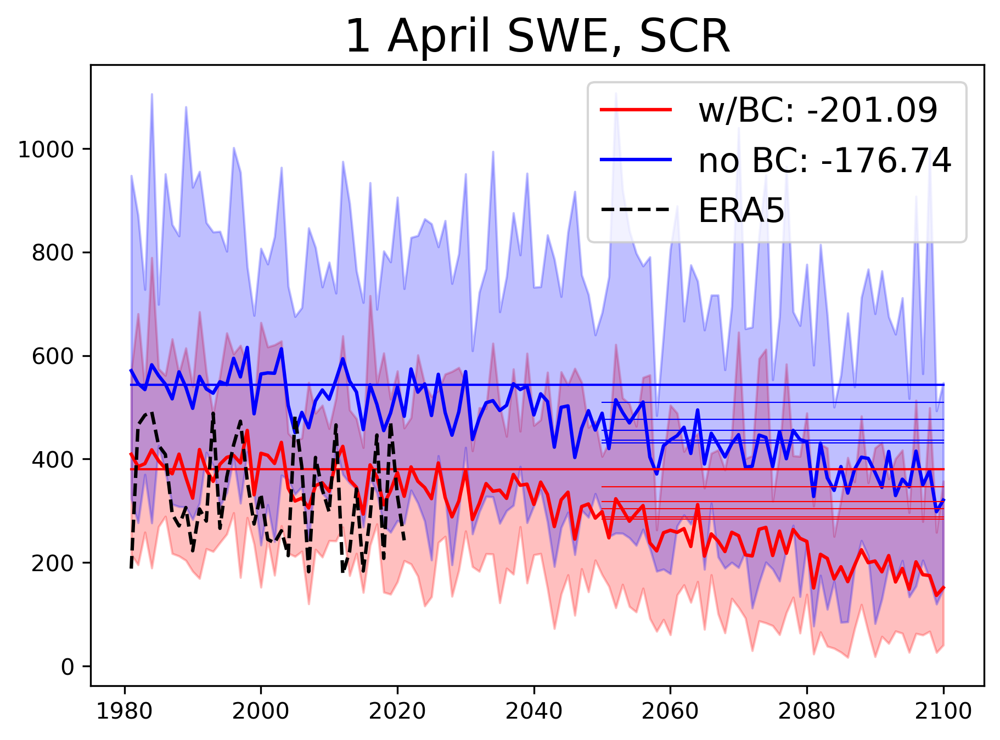

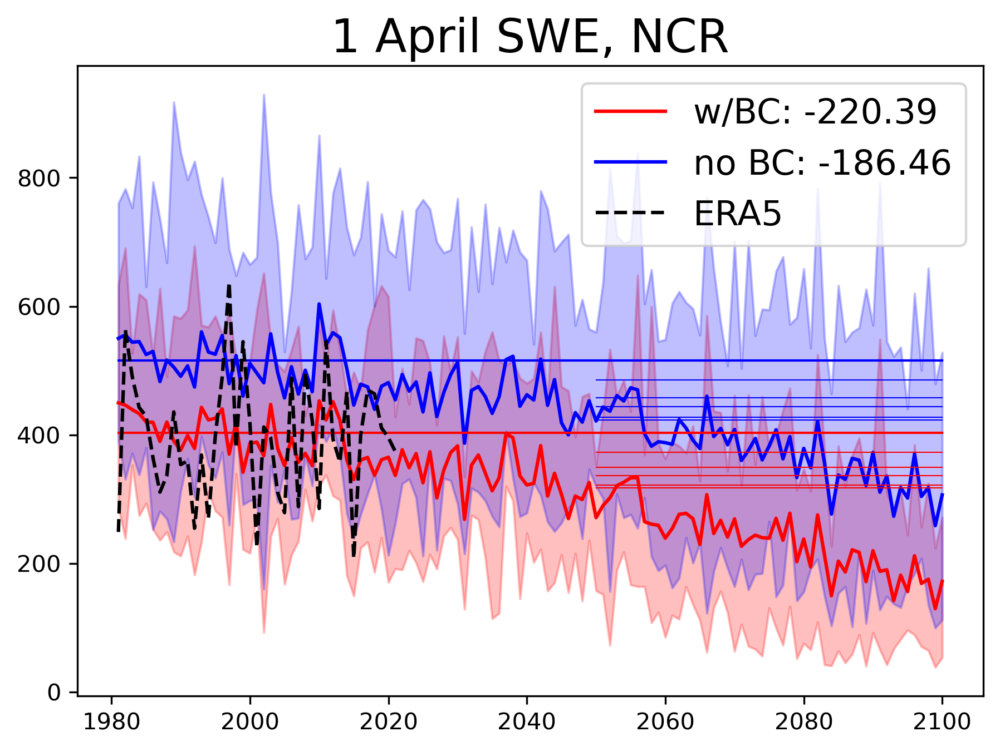

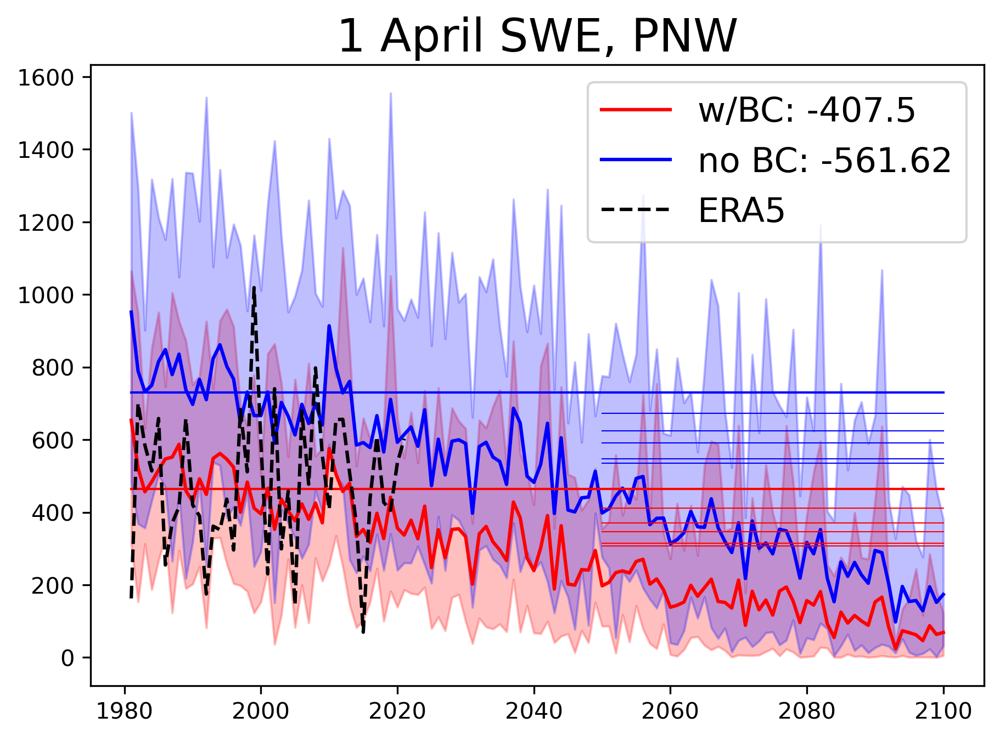

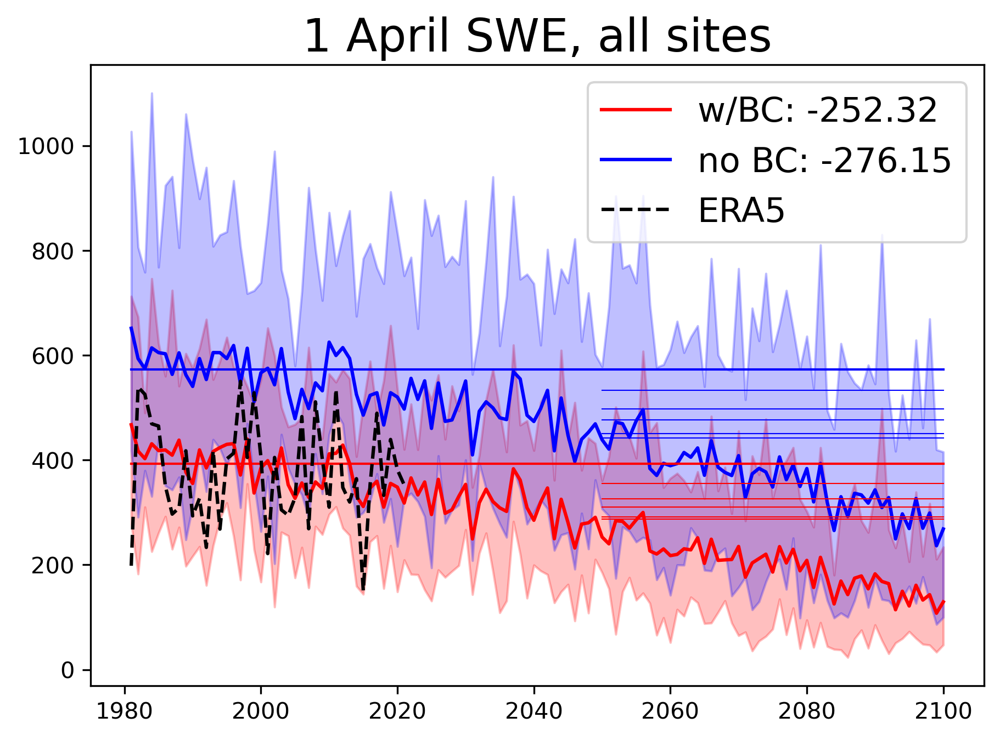

In [217]:
%%time

def _mask(array,bounds):
    
    array = \
        xr.where( ( (array.lat >= bounds[0]) & \
                     (array.lat <= bounds[1]) &
                     (array.lon >= bounds[2]) & \
                     (array.lon <= bounds[3]) ),
                 array,
                 np.nan
                   )

    return (array)


regions = ['SW','SCR','NCR','PNW','all sites']
bound_arrays = [[35., 42., -121., -114.],
               [35., 42., -114., -105.],
               [42., 49., -117., -107.],
               [42., 49., -125., -117.],
               [35,49,-125,-105]]

month = 4

for icount, iregion in enumerate(bound_arrays):
    
    bc = _mask(snow_SNOTELfromWRF_BC,iregion)
    nobc = _mask(snow_SNOTELfromWRF_noBC,iregion).sel(gcm=bc.gcm)
    era5 = _mask(snow_SNOTELfromWRF_ERA5,iregion)

    q = [0.001,0.01,0.05,0.1,0.25,0.5]
    array = bc.mean('gcm').sel(time=bc.time.dt.month == month)
    historical = array.sel(time=slice('1980','2014'))
    bc_p = historical.quantile(q,'time',keep_attrs=False).mean('site')
    
    array = nobc.mean('gcm').sel(time=nobc.time.dt.month == month)
    historical = array.sel(time=slice('1980','2014'))
    nobc_p = historical.quantile(q,'time',keep_attrs=False).mean('site')
    
    bc = bc.sel(time=(bc.time.dt.month == month) ).mean('site')
    nobc = nobc.sel(time=(nobc.time.dt.month == month) ).mean('site')
    era5 = era5.sel(time=(era5.time.dt.month == month) ).mean('site')
    era5 = era5.sel(time=slice('1981','2021'))
    title = '1 April SWE, %s' %(regions[icount])

    _plotTimeSeries(icount+1,
                        bc,nobc,era5,
                        title,
                   bc_p,nobc_p,True)
    
gc.collect()

# Bias as a funtion of change signal 

SW
/home/tornerdo/WRF/climate_change/hello_world_paper/files/snow_snotel_ts_day_SW.nc


/work/srahimi/clone/lib/python3.7/site-packages/ipykernel_launcher.py:48: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.


SCR
/home/tornerdo/WRF/climate_change/hello_world_paper/files/snow_snotel_ts_day_SCR.nc


/work/srahimi/clone/lib/python3.7/site-packages/ipykernel_launcher.py:48: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.


NCR
/home/tornerdo/WRF/climate_change/hello_world_paper/files/snow_snotel_ts_day_NCR.nc


/work/srahimi/clone/lib/python3.7/site-packages/ipykernel_launcher.py:48: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.


PNW
/home/tornerdo/WRF/climate_change/hello_world_paper/files/snow_snotel_ts_day_PNW.nc


/work/srahimi/clone/lib/python3.7/site-packages/ipykernel_launcher.py:48: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.


all sites
/home/tornerdo/WRF/climate_change/hello_world_paper/files/snow_snotel_ts_day_ALL.nc


/work/srahimi/clone/lib/python3.7/site-packages/ipykernel_launcher.py:48: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.


CPU times: user 1.7 s, sys: 461 ms, total: 2.16 s
Wall time: 2.14 s


22371

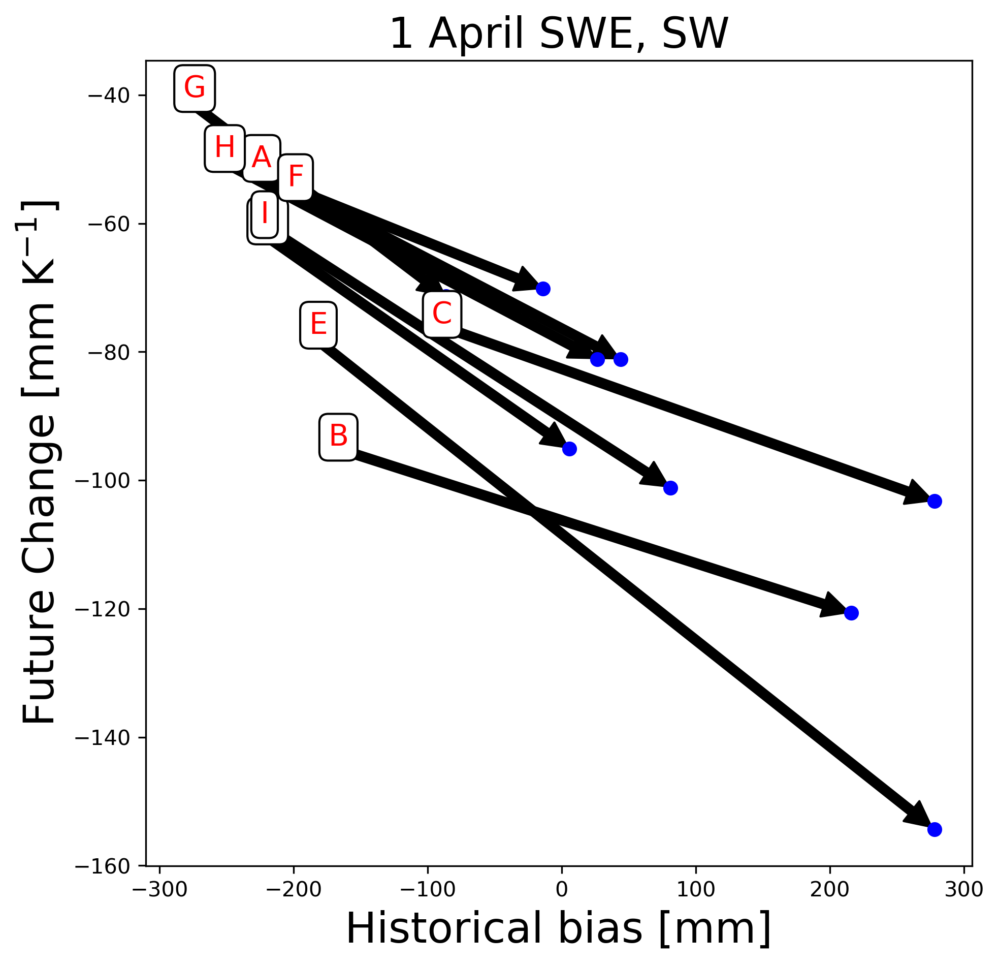

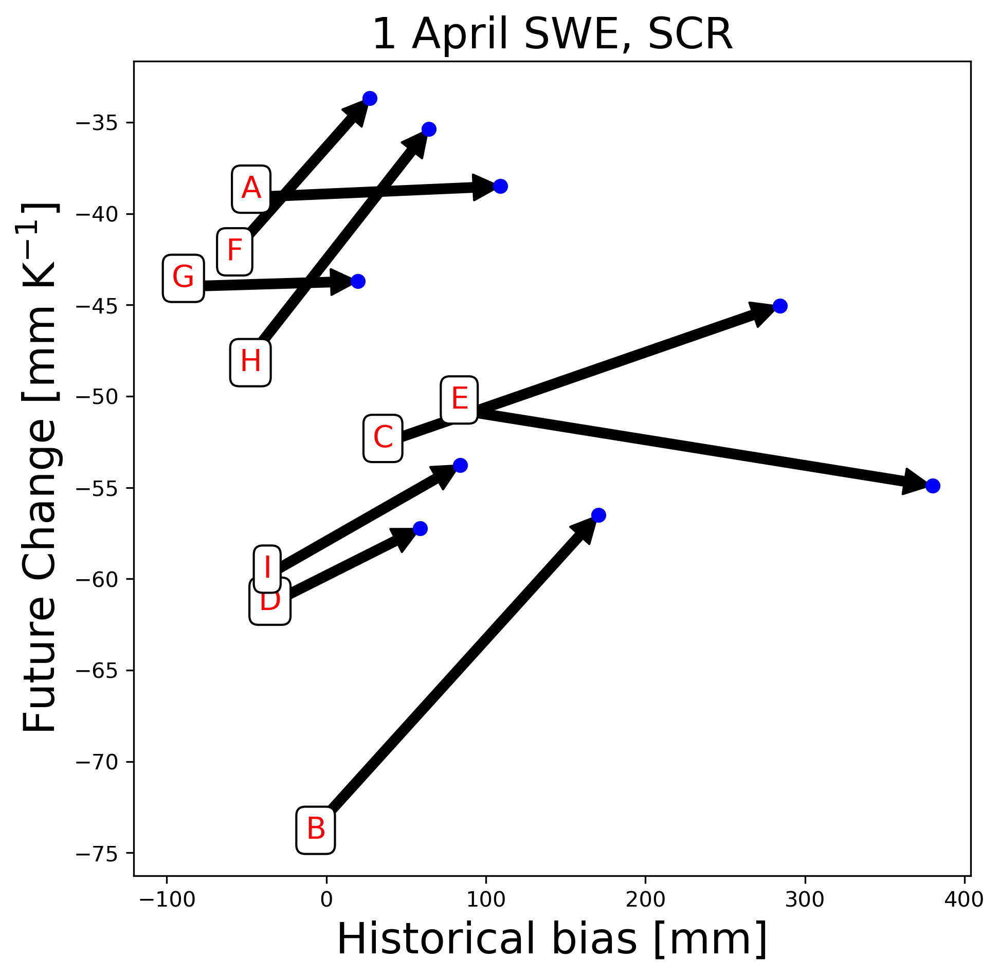

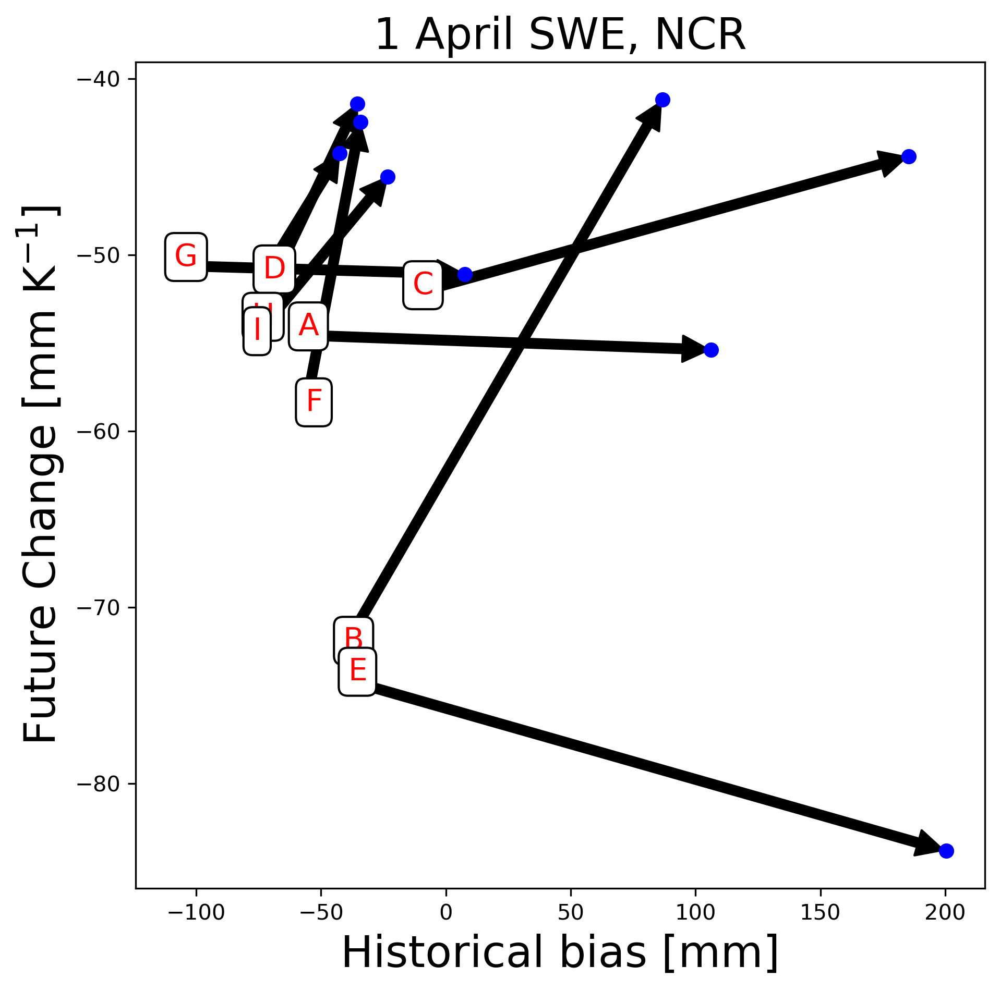

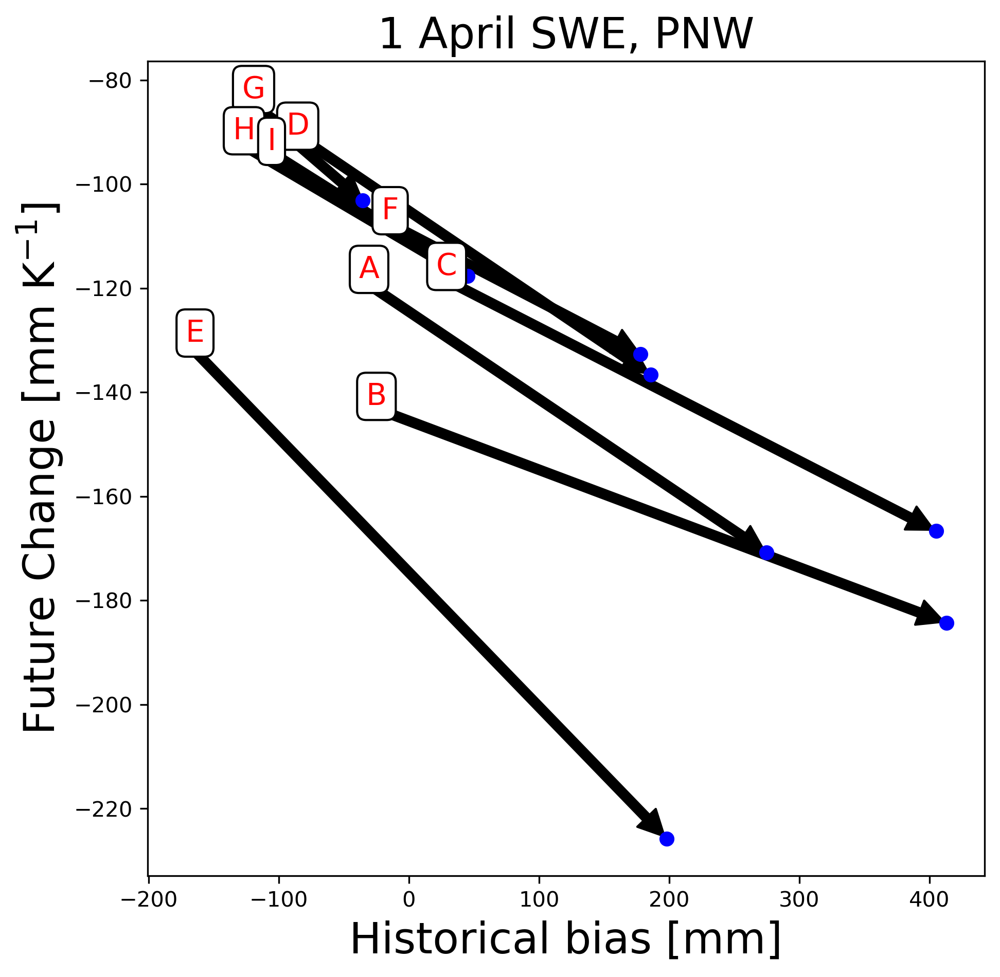

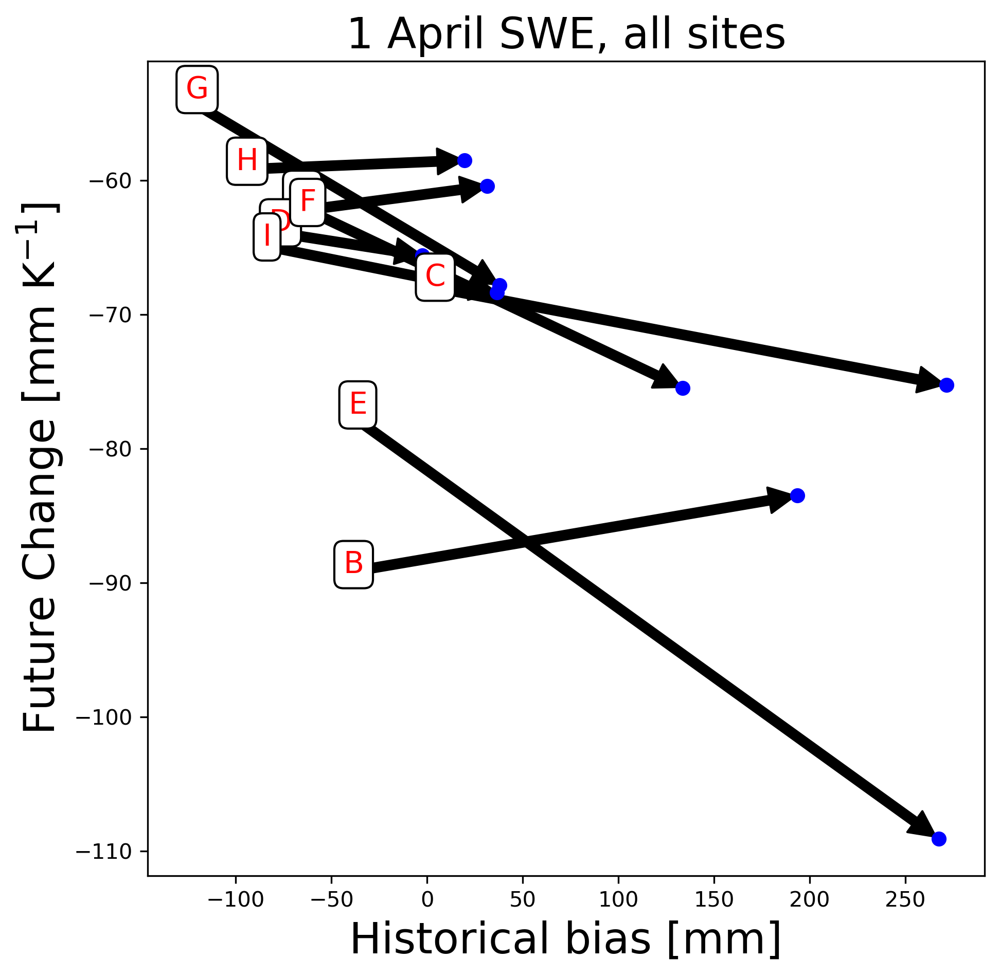

In [226]:
%%time

import string

for icount, iregion in enumerate(bound_arrays):
    
    bc = _mask(snow_SNOTELfromWRF_BC,iregion).sel(time=snow_SNOTELfromWRF_BC.time.dt.month == 4)
    nobc = _mask(snow_SNOTELfromWRF_noBC,iregion).sel(gcm=bc.gcm).sel(time=snow_SNOTELfromWRF_noBC.time.dt.month == 4)
    era5 = _mask(snow_SNOTELfromWRF_ERA5,iregion).sel(time=snow_SNOTELfromWRF_ERA5.time.dt.month == 4)

    print (regions[icount])
    
    if regions[icount] == 'all sites':
        file = '/home/tornerdo/WRF/climate_change/hello_world_paper/files/snow_snotel_ts_day_ALL.nc'
        snotel_max = xr.open_dataset(file).daily.max().values
        print (file)
    else:
        file = '/home/tornerdo/WRF/climate_change/hello_world_paper/files/snow_snotel_ts_day_%s.nc' %(regions[icount])
        print (file)
        snotel_max = xr.open_dataset(file).daily.max().values
    
    bias_bc = bc.sel(time=slice('1981','2010')).mean(['time','site'])  - snotel_max
    bias_nobc = nobc.sel(time=slice('1981','2010')).mean(['time','site'])   - snotel_max

    bc = bc.sel(time=(bc.time.dt.month == month) ).mean('site')
    bc = bc.sel(time=slice('2070','2100')).mean('time') - \
         bc.sel(time=slice('1981','2010')).mean('time')
    
    nobc = nobc.sel(time=(nobc.time.dt.month == month) ).mean('site')
    nobc = nobc.sel(time=slice('2070','2100')).mean('time') - \
           nobc.sel(time=slice('1981','2010')).mean('time')
    
    bc = bc / global_DeltaTemperatures.sel(month=4)
    nobc = nobc / global_DeltaTemperatures.sel(month=4)
    
    P.figure(icount+1,figsize=(7,7),dpi=300 )    
    title = '1 April SWE, %s' %(regions[icount])
    P.title(title,fontsize=20)

    letters = list(string.ascii_uppercase)
    
    for count_gcm, igcm in enumerate(bias_bc.gcm):

        P.scatter(bias_nobc.sel(gcm=igcm),nobc.sel(gcm=igcm),marker='o',color='b')
        P.scatter(bias_bc.sel(gcm=igcm),bc.sel(gcm=igcm),marker='o',color='b',s=0.00001)
        
        P.annotate("", xytext=(bias_bc.sel(gcm=igcm),bc.sel(gcm=igcm) ), 
                   xy=(bias_nobc.sel(gcm=igcm),nobc.sel(gcm=igcm) ),
          arrowprops=dict(facecolor='black', shrink=0.005,color='k'),
          zorder=0)
        
        P.annotate(letters[count_gcm], xy=(bias_bc.sel(gcm=igcm),bc.sel(gcm=igcm) ),
                    xytext=(bias_bc.sel(gcm=igcm),bc.sel(gcm=igcm) ),
                  color='r',
                  fontsize=14,
                  bbox=dict(boxstyle="round", fc="1"))
    
    P.xlabel('Historical bias [mm]',fontsize=20)
    P.ylabel('Future Change [mm K$^{-1}$]',fontsize=20)
    #P.axis([-500,-200,-500,-100])
    #break
    

gc.collect()

# 1 June

/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfun

CPU times: user 2.12 s, sys: 716 ms, total: 2.84 s
Wall time: 2.81 s


22584

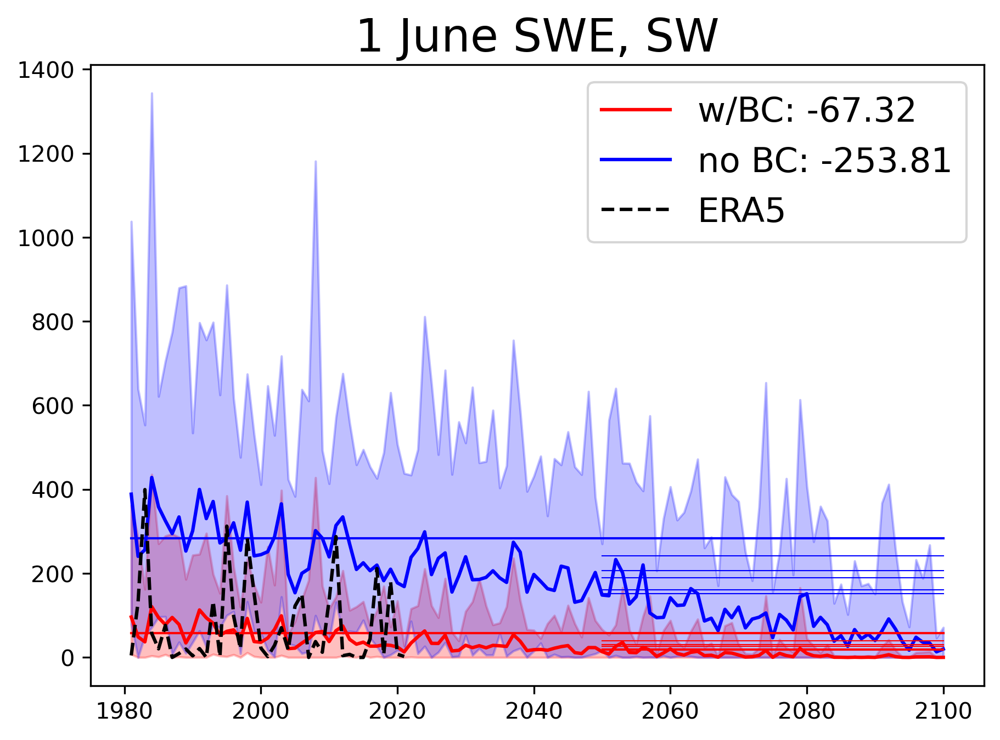

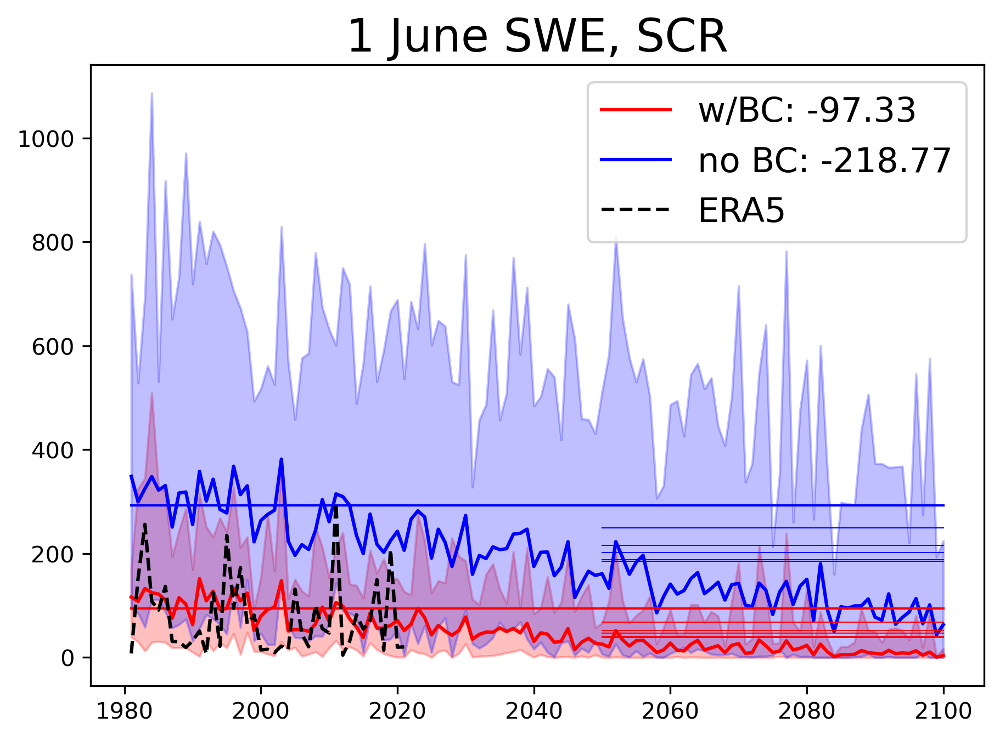

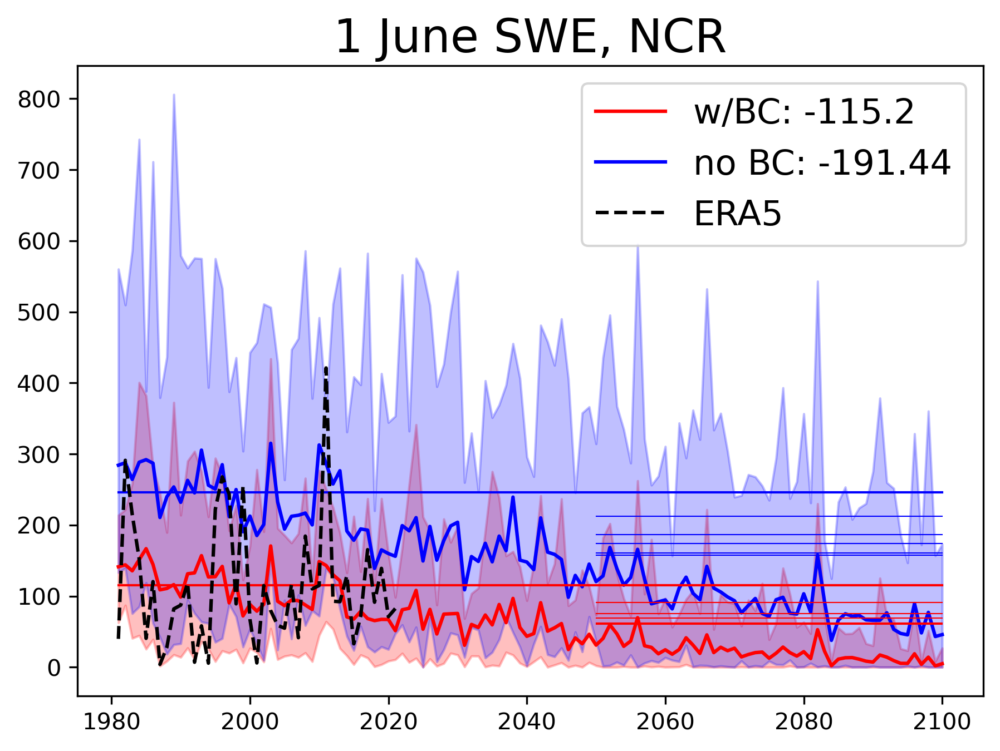

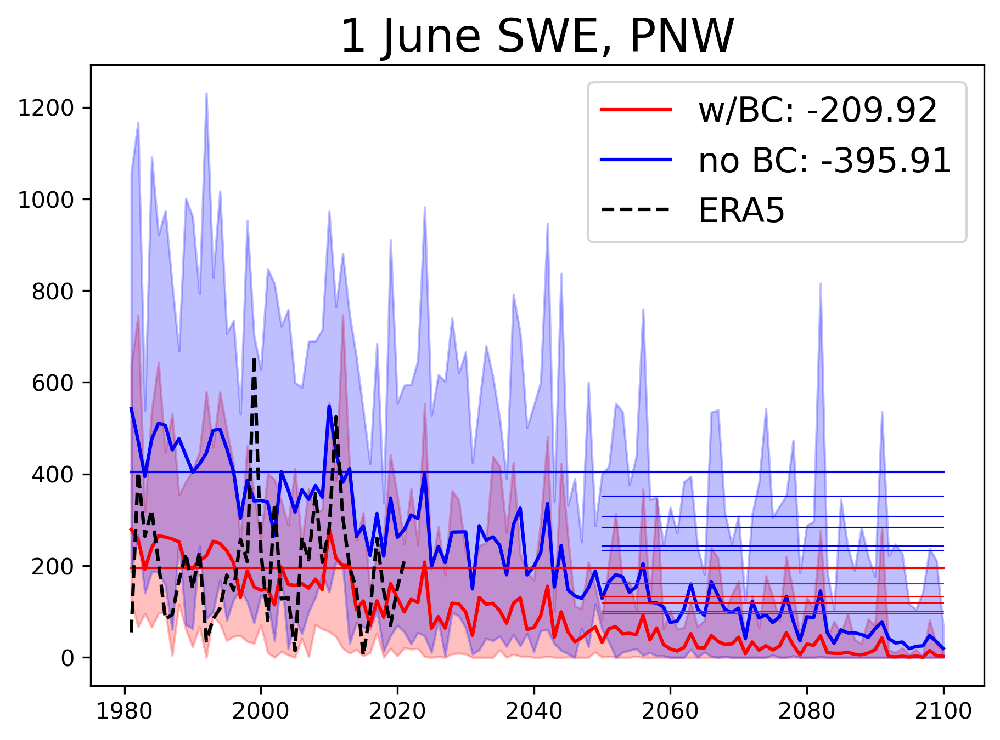

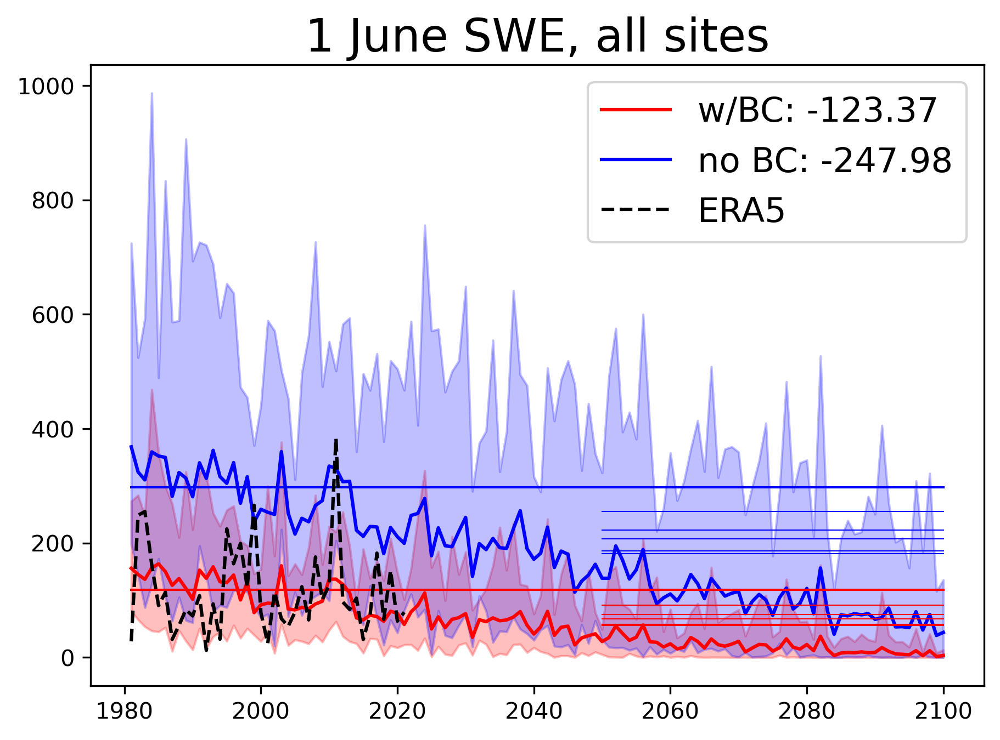

In [227]:
%%time

month = 6

for icount, iregion in enumerate(bound_arrays):
    
    bc = _mask(snow_SNOTELfromWRF_BC,iregion)
    nobc = _mask(snow_SNOTELfromWRF_noBC,iregion).sel(gcm=bc.gcm)
    era5 = _mask(snow_SNOTELfromWRF_ERA5,iregion)

    array = bc.mean('gcm').sel(time=bc.time.dt.month == month)
    historical = array.sel(time=slice('1980','2014'))
    bc_p = historical.quantile(q,'time',keep_attrs=False).mean('site')
    
    array = nobc.mean('gcm').sel(time=nobc.time.dt.month == month)
    historical = array.sel(time=slice('1980','2014'))
    nobc_p = historical.quantile(q,'time',keep_attrs=False).mean('site')
        
    bc = bc.sel(time=(bc.time.dt.month == month) ).mean('site')
    nobc = nobc.sel(time=(nobc.time.dt.month == month) ).mean('site')
    era5 = era5.sel(time=(era5.time.dt.month == month) ).mean('site')
    era5 = era5.sel(time=slice('1981','2021'))
    title = '1 June SWE, %s' %(regions[icount])

    _plotTimeSeries(icount+1,
                        bc,nobc,era5,
                        title,
                   bc_p,nobc_p,True)
    
gc.collect()

# July

/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1396: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/work/srahimi/clone/lib/python3.7/site-packages/numpy/lib/nanfun

CPU times: user 2.07 s, sys: 658 ms, total: 2.73 s
Wall time: 2.7 s


20308

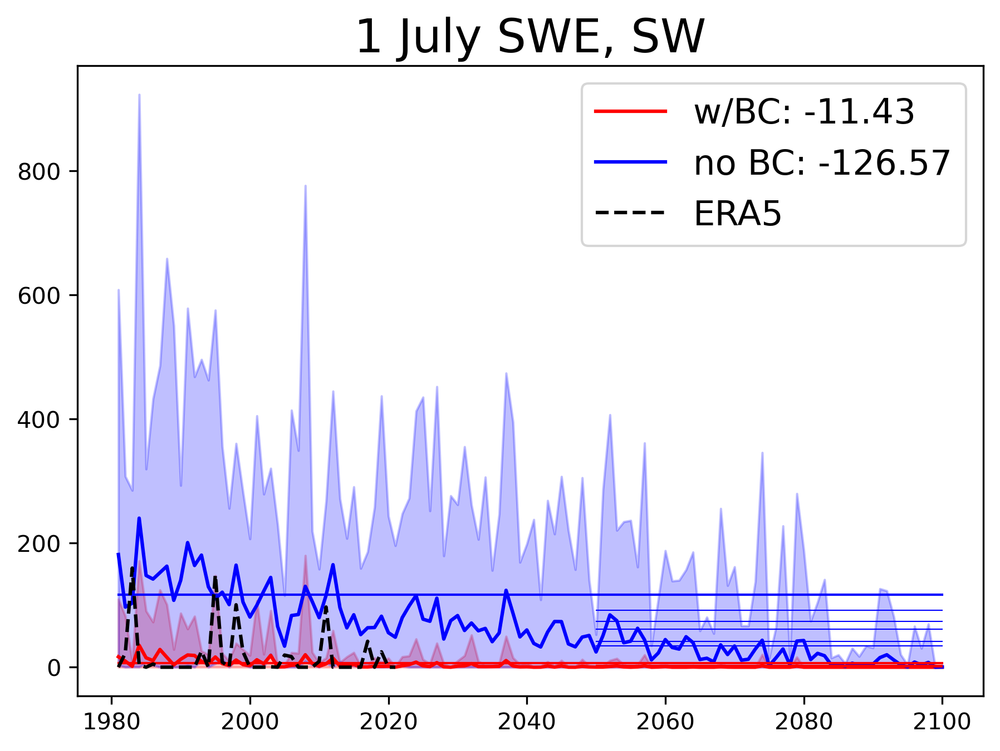

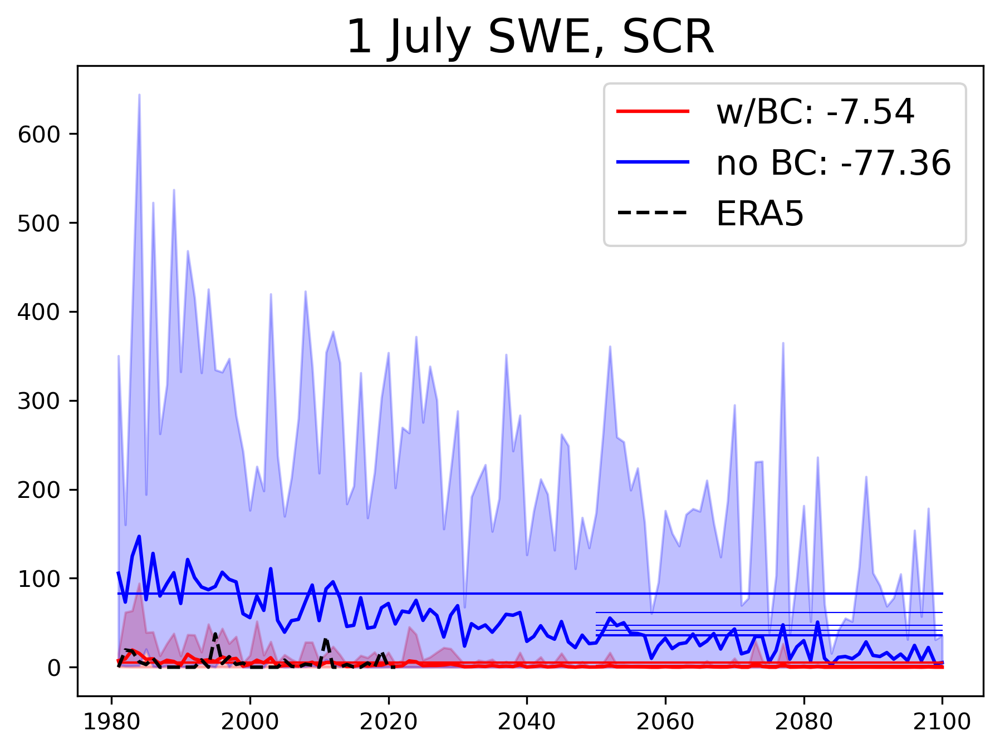

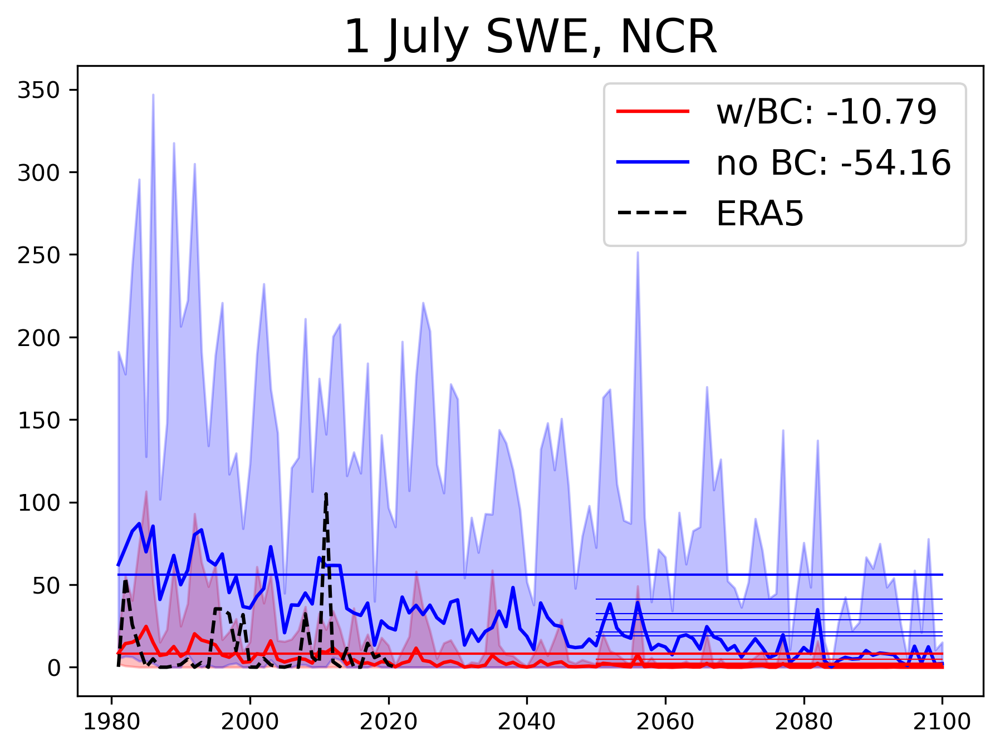

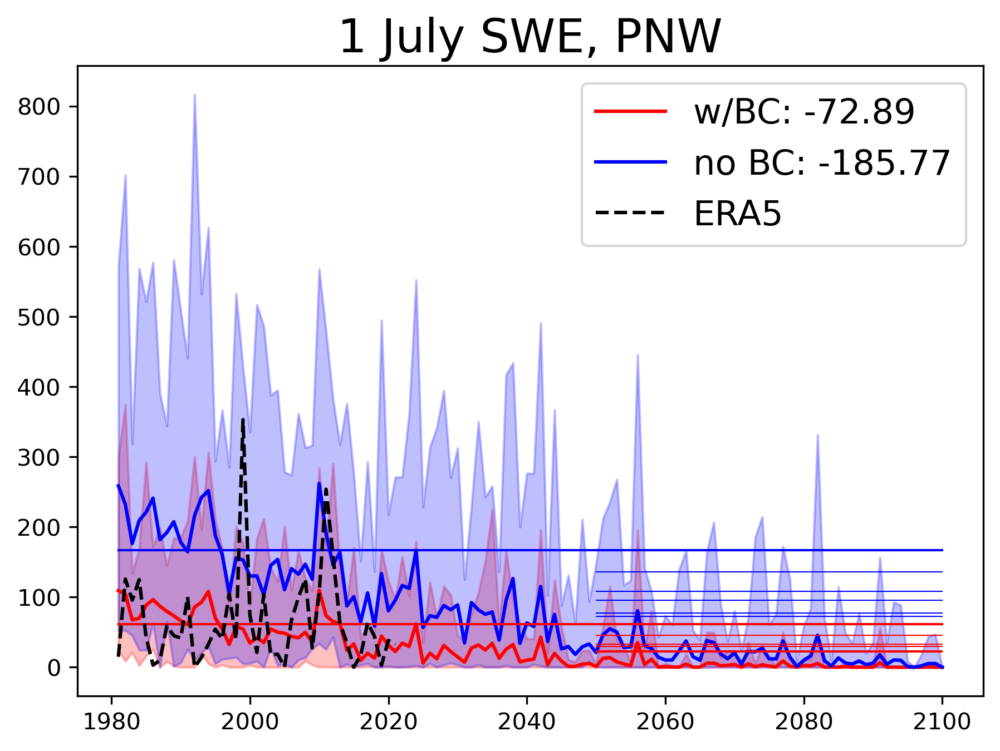

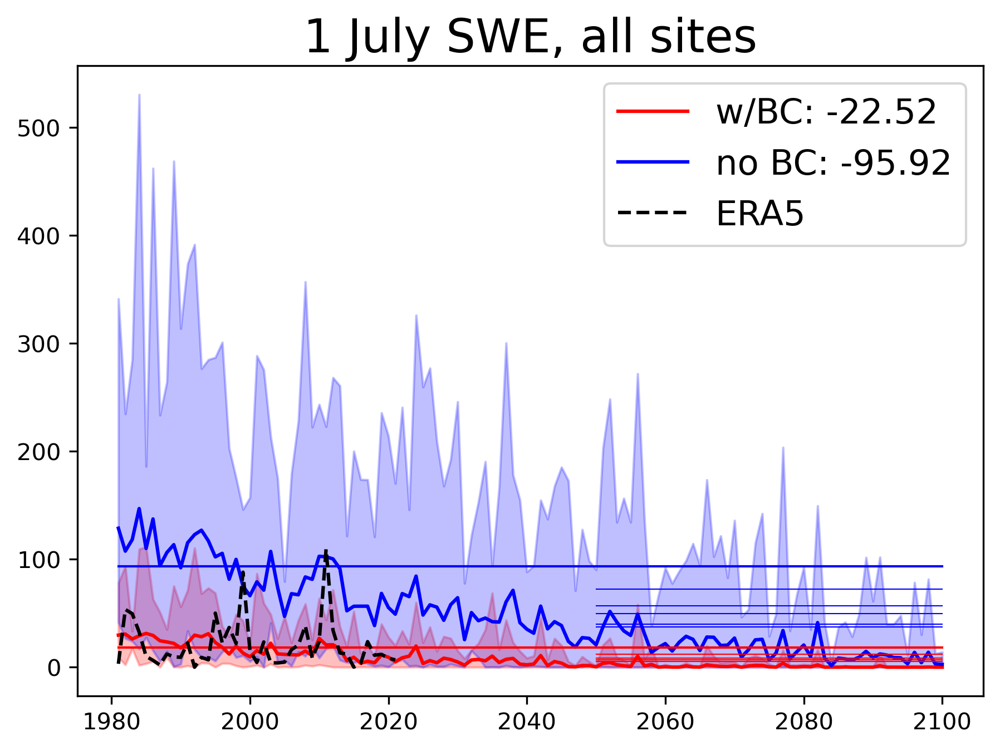

In [228]:
%%time

month = 7

for icount, iregion in enumerate(bound_arrays):
    
    bc = _mask(snow_SNOTELfromWRF_BC,iregion)
    nobc = _mask(snow_SNOTELfromWRF_noBC,iregion).sel(gcm=bc.gcm)
    era5 = _mask(snow_SNOTELfromWRF_ERA5,iregion)
    
    array = bc.mean('gcm').sel(time=bc.time.dt.month == month)
    historical = array.sel(time=slice('1980','2014'))
    bc_p = historical.quantile(q,'time',keep_attrs=False).mean('site')
    
    array = nobc.mean('gcm').sel(time=nobc.time.dt.month == month)
    historical = array.sel(time=slice('1980','2014'))
    nobc_p = historical.quantile(q,'time',keep_attrs=False).mean('site')
    
    bc = bc.sel(time=(bc.time.dt.month == month) ).mean('site')
    nobc = nobc.sel(time=(nobc.time.dt.month == month) ).mean('site')
    era5 = era5.sel(time=(era5.time.dt.month == month) ).mean('site')
    era5 = era5.sel(time=slice('1981','2021'))
    title = '1 July SWE, %s' %(regions[icount])

    _plotTimeSeries(icount+1,
                        bc,nobc,era5,
                        title,
                   bc_p,nobc_p,True)
    
gc.collect()

# Maximum annual daily snow

In [165]:
%%time

def _ComputeMax(array):
    
    #Must consider the increment; not the max value
    
    historical = array.sel(time=slice('1981','2010')).diff('time')
    historical = historical.groupby('time.year').max()
    future = array.sel(time=slice('2070','2100')).diff('time')
    future = future.groupby('time.year').max()
    
    diff = future.mean('year') - historical.mean('year')
    
    return (diff.load())
    
gc.collect()

CPU times: user 427 ms, sys: 71.9 ms, total: 499 ms
Wall time: 494 ms


7280

In [166]:
%%time

max_snow_noBC = []

for count, igcm in enumerate(snow_noBC.keys()):

    max_snow_noBC.append( _ComputeMax(snow_noBC[igcm]) )
    
    print (igcm)

max_snow_noBC = xr.concat(max_snow_noBC,dim='gcm')
max_snow_noBC['gcm'] = keys

gc.collect()

cesm2_r11i1p1f1_ssp370
mpi-esm1-2-lr_r7i1p1f1_ssp370
cnrm-esm2-1_r1i1p1f2_ssp370
ec-earth3-veg_r1i1p1f1_ssp370
fgoals-g3_r1i1p1f1_ssp370
ukesm1-0-ll_r2i1p1f2_ssp370
canesm5_r1i1p2f1_ssp370
access-cm2_r5i1p1f1_ssp370
ec-earth3_r1i1p1f1_ssp370
miroc6_r1i1p1f1_ssp370
noresm2-mm_r1i1p1f1_ssp370
mpi-esm1-2-hr_r7i1p1f1_ssp370
taiesm1_r1i1p1f1_ssp370
giss-e2-1-g_r1i1p1f2_ssp370
cesm2_r11i1p1f1_ssp245
cesm2_r11i1p1f1_ssp585
CPU times: user 5min 35s, sys: 8min 21s, total: 13min 56s
Wall time: 5min 44s


12218

['cesm2_r11i1p1f1_ssp370' 'mpi-esm1-2-lr_r7i1p1f1_ssp370'
 'cnrm-esm2-1_r1i1p1f2_ssp370' 'ec-earth3-veg_r1i1p1f1_ssp370'
 'fgoals-g3_r1i1p1f1_ssp370' 'ukesm1-0-ll_r2i1p1f2_ssp370'
 'canesm5_r1i1p2f1_ssp370' 'access-cm2_r5i1p1f1_ssp370'
 'ec-earth3_r1i1p1f1_ssp370' 'miroc6_r1i1p1f1_ssp370'
 'noresm2-mm_r1i1p1f1_ssp370' 'mpi-esm1-2-hr_r7i1p1f1_ssp370'
 'taiesm1_r1i1p1f1_ssp370' 'giss-e2-1-g_r1i1p1f2_ssp370'
 'cesm2_r11i1p1f1_ssp245' 'cesm2_r11i1p1f1_ssp585']
16.67370400562945
CPU times: user 785 ms, sys: 48.7 ms, total: 834 ms
Wall time: 827 ms


5301

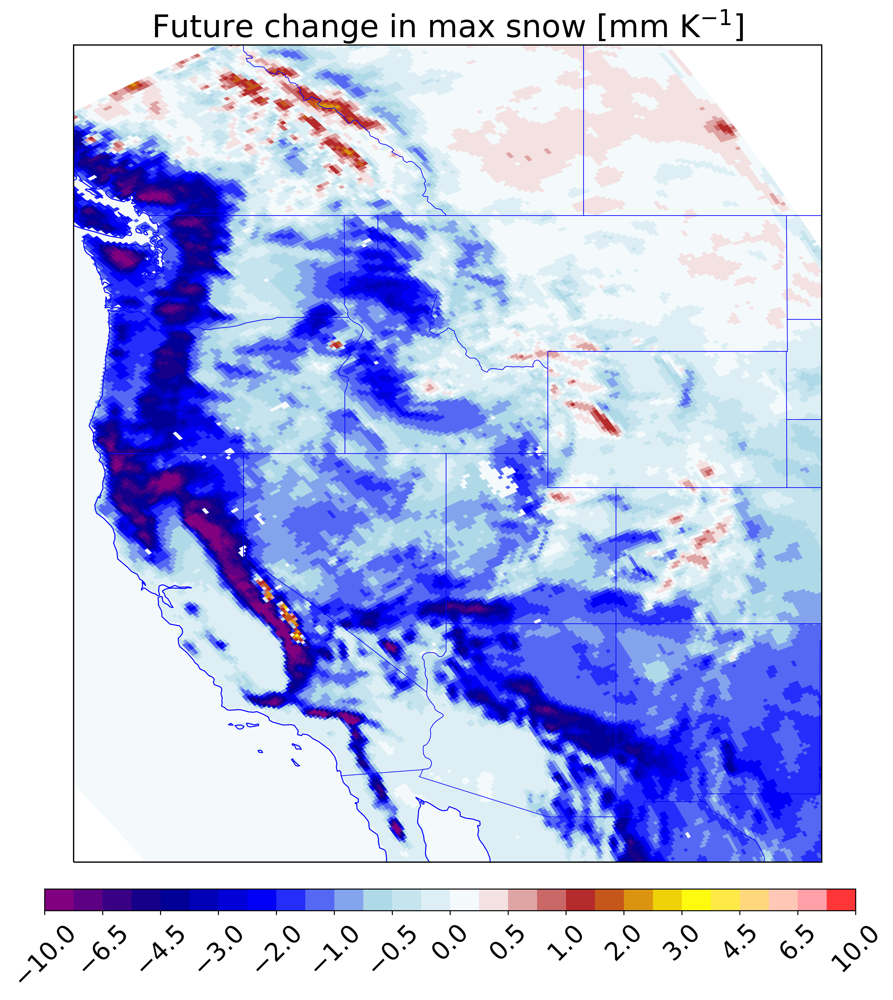

In [182]:
%%time

levs = [-200,-150,-130,-110,-90,-70,-60,-50,-40,-30,-20,-15,-10,-5,0,
        5,10,15,20,30,40,50,60,70,90,110,130,150,200]
levs = np.array(levs) / 20.
mycmap = ["purple","darkblue","blue","lightblue",
          "white",
          "firebrick","yellow","pink","red"]
title = 'Future change in max snow [mm K$^{-1}$]'

diff = max_snow_noBC

diff = diff / global_DeltaTemperatures.mean('month')
print (diff.gcm.values)
print (diff.max().values)
diff = diff.mean('gcm')

_plotSingle(1,levs,mycmap,
                diff,
                title)

gc.collect()

In [171]:
%%time

max_snow_BC = []

for count, igcm in enumerate(snow_BC.keys()):

    max_snow_BC.append( _ComputeMax(snow_BC[igcm]) )
    
    print (igcm)

max_snow_BC = xr.concat(max_snow_BC,dim='gcm')
max_snow_BC['gcm'] = keys[0:9]

gc.collect()

cesm2_r11i1p1f1_ssp370
mpi-esm1-2-lr_r7i1p1f1_ssp370
cnrm-esm2-1_r1i1p1f2_ssp370
ec-earth3-veg_r1i1p1f1_ssp370
fgoals-g3_r1i1p1f1_ssp370
ukesm1-0-ll_r2i1p1f2_ssp370
canesm5_r1i1p2f1_ssp370
access-cm2_r5i1p1f1_ssp370
ec-earth3_r1i1p1f1_ssp370
CPU times: user 3min 22s, sys: 4min 55s, total: 8min 18s
Wall time: 3min 48s


11441

['cesm2_r11i1p1f1_ssp370' 'mpi-esm1-2-lr_r7i1p1f1_ssp370'
 'cnrm-esm2-1_r1i1p1f2_ssp370' 'ec-earth3-veg_r1i1p1f1_ssp370'
 'fgoals-g3_r1i1p1f1_ssp370' 'ukesm1-0-ll_r2i1p1f2_ssp370'
 'canesm5_r1i1p2f1_ssp370' 'access-cm2_r5i1p1f1_ssp370'
 'ec-earth3_r1i1p1f1_ssp370']
CPU times: user 438 ms, sys: 26.9 ms, total: 465 ms
Wall time: 459 ms


4275

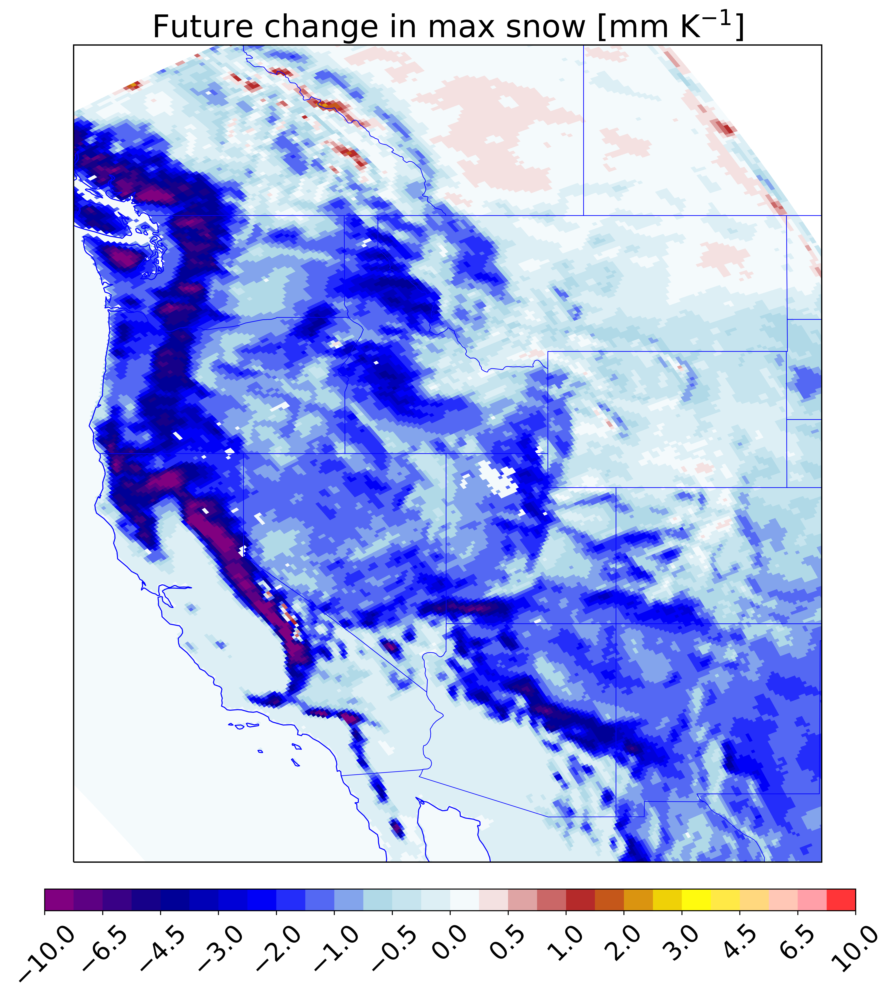

In [175]:
%%time

levs = [-200,-150,-130,-110,-90,-70,-60,-50,-40,-30,-20,-15,-10,-5,0,
        5,10,15,20,30,40,50,60,70,90,110,130,150,200]
levs = np.array(levs) / 20.
mycmap = ["purple","darkblue","blue","lightblue",
          "white",
          "firebrick","yellow","pink","red"]
title = 'Future change in max snow [mm K$^{-1}$]'

diff = max_snow_BC

diff = diff / global_DeltaTemperatures.mean('month')
print (diff.gcm.values)
diff = diff.mean('gcm')

_plotSingle(1,levs,mycmap,
                diff,
                title)

gc.collect()

['cesm2_r11i1p1f1_ssp370' 'mpi-esm1-2-lr_r7i1p1f1_ssp370'
 'cnrm-esm2-1_r1i1p1f2_ssp370' 'ec-earth3-veg_r1i1p1f1_ssp370'
 'fgoals-g3_r1i1p1f1_ssp370' 'ukesm1-0-ll_r2i1p1f2_ssp370'
 'canesm5_r1i1p2f1_ssp370' 'access-cm2_r5i1p1f1_ssp370'
 'ec-earth3_r1i1p1f1_ssp370']
CPU times: user 486 ms, sys: 31.9 ms, total: 518 ms
Wall time: 512 ms


4275

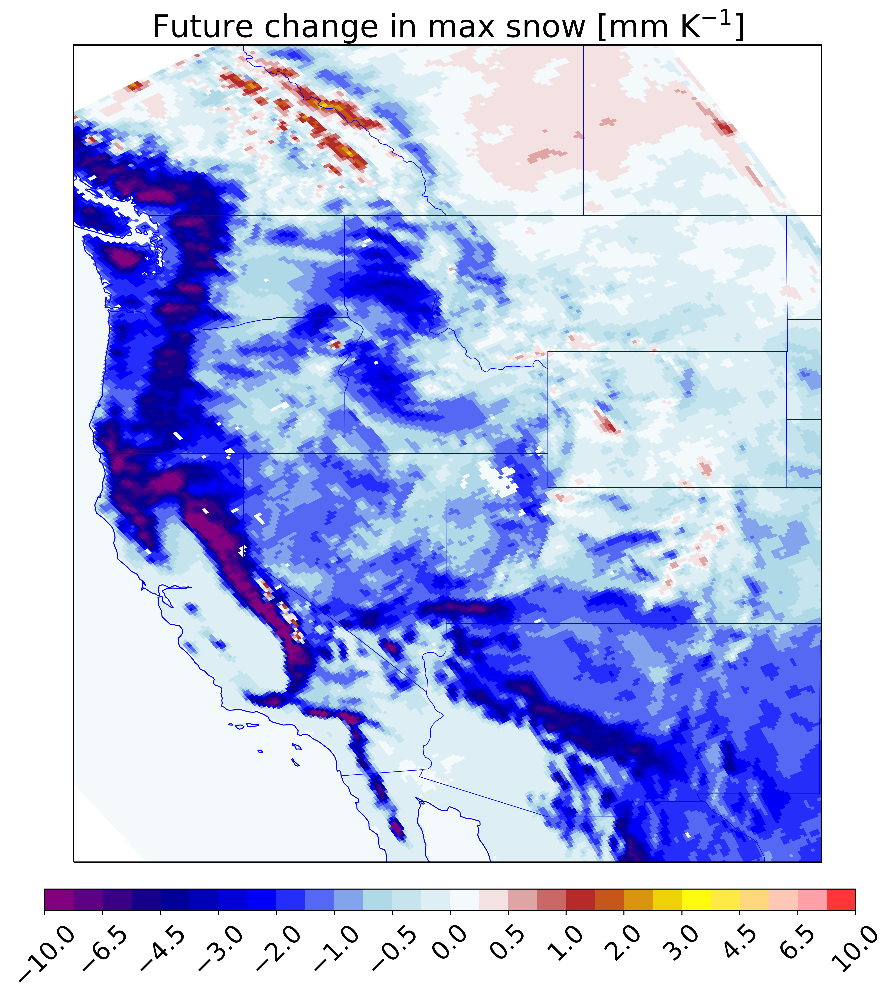

In [176]:
%%time

levs = [-200,-150,-130,-110,-90,-70,-60,-50,-40,-30,-20,-15,-10,-5,0,
        5,10,15,20,30,40,50,60,70,90,110,130,150,200]
levs = np.array(levs) / 20.
mycmap = ["purple","darkblue","blue","lightblue",
          "white",
          "firebrick","yellow","pink","red"]
title = 'Future change in max snow [mm K$^{-1}$]'

diff = max_snow_noBC.sel(gcm=max_snow_BC.gcm)

diff = diff / global_DeltaTemperatures.mean('month')
print (diff.gcm.values)
diff = diff.mean('gcm')

_plotSingle(1,levs,mycmap,
                diff,
                title)

gc.collect()

In [178]:
%%time

gcms = ['cesm2','mpi-esm1-2-lr','cnrm-esm2-1',
        'ec-earth3-veg','fgoals-g3','ukesm1-0-ll',
        'canesm5','access-cm2','ec-earth3',
        'miroc6','noresm2-mm','mpi-esm1-2-hr',
        'taiesm1','giss-e2-1-g','cesm2','cesm2']

variants = ['r11i1p1f1','r7i1p1f1','r1i1p1f2',
            'r1i1p1f1','r1i1p1f1','r2i1p1f2',
            'r1i1p2f1','r5i1p1f1','r1i1p1f1',
            'r1i1p1f1','r1i1p1f1','r7i1p1f1',
            'r1i1p1f1','r1i1p1f2','r11i1p1f1',
            'r11i1p1f1']

calendar = ['365_day','proleptic_gregorian','proleptic_gregorian',
            'proleptic_gregorian','365_day','360_day',
             '365_day','proleptic_gregorian','proleptic_gregorian',
            'proleptic_gregorian','365_day', 'proleptic_gregorian',
            '365_day','365_day','365_day','365_day']

ssps = ['ssp370','ssp370','ssp370','ssp370',
        'ssp370','ssp370','ssp370','ssp370',
        'ssp370','ssp370','ssp370','ssp370',
        'ssp370','ssp370',
        'ssp245','ssp585']

print (len(ssps),len(calendar),len(variants),len(gcms))

dir = "/data/modelOutput/WRF_2020"

prec_snow_noBC = {}
prec_snow_BC = {}
prec_noBC = {}
prec_BC = {}

for count, igcm in enumerate(gcms):
    
    condition = ()
    
    bc = False
    var = 'prec_snow'
    
    key = '%s_%s_%s' %(igcm,variants[count],ssps[count])
    print (key)
    
    var = _read_merge(dir,domain,var,
                                        igcm,variants[count], \
                                        date_start_hist,date_start_ssp, \
                                        date_end_hist,date_end_ssp,ssps[count],bc,
            calendar[count]).assign_coords(coords)
    
    prec_snow_noBC[key] = var

    var = 'prec'
    var = _read_merge(dir,domain,var,
                                        igcm,variants[count], \
                                        date_start_hist,date_start_ssp, \
                                        date_end_hist,date_end_ssp,ssps[count],bc,
            calendar[count]).assign_coords(coords)
    
    prec_noBC[key] = var
    
    if count < 9:
        bc = True
        var = 'prec_snow'
        var = _read_merge(dir,domain,var,
                                            igcm,variants[count], \
                                            date_start_hist,date_start_ssp, \
                                            date_end_hist,date_end_ssp,ssps[count],bc,
                calendar[count]).assign_coords(coords)

        prec_snow_BC[key] = var

        var = 'prec'
        var = _read_merge(dir,domain,var,
                                            igcm,variants[count], \
                                            date_start_hist,date_start_ssp, \
                                            date_end_hist,date_end_ssp,ssps[count],bc,
                calendar[count]).assign_coords(coords)

        prec_BC[key] = var
        
gc.collect()

16 16 16 16
cesm2_r11i1p1f1_ssp370
365_day 2014-08-31 2100-08-31
cesm2 r11i1p1f1 False ssp370
365_day 2014-08-31 2100-08-31
cesm2 r11i1p1f1 False ssp370
365_day 2014-08-31 2100-08-31
cesm2 r11i1p1f1 True ssp370
365_day 2014-08-31 2100-08-31
cesm2 r11i1p1f1 True ssp370
mpi-esm1-2-lr_r7i1p1f1_ssp370
proleptic_gregorian 2014-08-31 2100-08-31
mpi-esm1-2-lr r7i1p1f1 False ssp370
proleptic_gregorian 2014-08-31 2100-08-31
mpi-esm1-2-lr r7i1p1f1 False ssp370
proleptic_gregorian 2014-08-31 2100-08-31
mpi-esm1-2-lr r7i1p1f1 True ssp370
proleptic_gregorian 2014-08-31 2100-08-31
mpi-esm1-2-lr r7i1p1f1 True ssp370
cnrm-esm2-1_r1i1p1f2_ssp370
proleptic_gregorian 2014-08-31 2100-08-31
cnrm-esm2-1 r1i1p1f2 False ssp370
proleptic_gregorian 2014-08-31 2100-08-31
cnrm-esm2-1 r1i1p1f2 False ssp370
proleptic_gregorian 2014-08-31 2100-08-31
cnrm-esm2-1 r1i1p1f2 True ssp370
proleptic_gregorian 2014-08-31 2100-08-31
cnrm-esm2-1 r1i1p1f2 True ssp370
ec-earth3-veg_r1i1p1f1_ssp370
proleptic_gregorian 2014-08-31 

17224

In [179]:
%%time

def _rx1(array):
        
    historical = array.sel(time=slice('1981','2010'))
    historical = historical.groupby('time.year').max()
    future = array.sel(time=slice('2070','2100'))
    future = future.groupby('time.year').max()
    
    diff = future.mean('year') - historical.mean('year')
    
    return (diff.load())
    
gc.collect()

CPU times: user 742 ms, sys: 65.3 ms, total: 807 ms
Wall time: 797 ms


58

In [180]:
%%time

max_prec_snow_noBC = []

for count, igcm in enumerate(prec_snow_noBC.keys()):

    max_prec_snow_noBC.append( _rx1(prec_snow_noBC[igcm]) )
    
    print (igcm)

max_prec_snow_noBC = xr.concat(max_prec_snow_noBC,dim='gcm')
max_prec_snow_noBC['gcm'] = keys

gc.collect()

cesm2_r11i1p1f1_ssp370
mpi-esm1-2-lr_r7i1p1f1_ssp370
cnrm-esm2-1_r1i1p1f2_ssp370
ec-earth3-veg_r1i1p1f1_ssp370
fgoals-g3_r1i1p1f1_ssp370
ukesm1-0-ll_r2i1p1f2_ssp370
canesm5_r1i1p2f1_ssp370
access-cm2_r5i1p1f1_ssp370
ec-earth3_r1i1p1f1_ssp370
miroc6_r1i1p1f1_ssp370
noresm2-mm_r1i1p1f1_ssp370
mpi-esm1-2-hr_r7i1p1f1_ssp370
taiesm1_r1i1p1f1_ssp370
giss-e2-1-g_r1i1p1f2_ssp370
cesm2_r11i1p1f1_ssp245
cesm2_r11i1p1f1_ssp585
CPU times: user 5min 1s, sys: 6min 50s, total: 11min 51s
Wall time: 5min 45s


12218

['cesm2_r11i1p1f1_ssp370' 'mpi-esm1-2-lr_r7i1p1f1_ssp370'
 'cnrm-esm2-1_r1i1p1f2_ssp370' 'ec-earth3-veg_r1i1p1f1_ssp370'
 'fgoals-g3_r1i1p1f1_ssp370' 'ukesm1-0-ll_r2i1p1f2_ssp370'
 'canesm5_r1i1p2f1_ssp370' 'access-cm2_r5i1p1f1_ssp370'
 'ec-earth3_r1i1p1f1_ssp370' 'miroc6_r1i1p1f1_ssp370'
 'noresm2-mm_r1i1p1f1_ssp370' 'mpi-esm1-2-hr_r7i1p1f1_ssp370'
 'taiesm1_r1i1p1f1_ssp370' 'giss-e2-1-g_r1i1p1f2_ssp370'
 'cesm2_r11i1p1f1_ssp245' 'cesm2_r11i1p1f1_ssp585']
8.465448189427102
CPU times: user 792 ms, sys: 67 ms, total: 859 ms
Wall time: 849 ms


4275

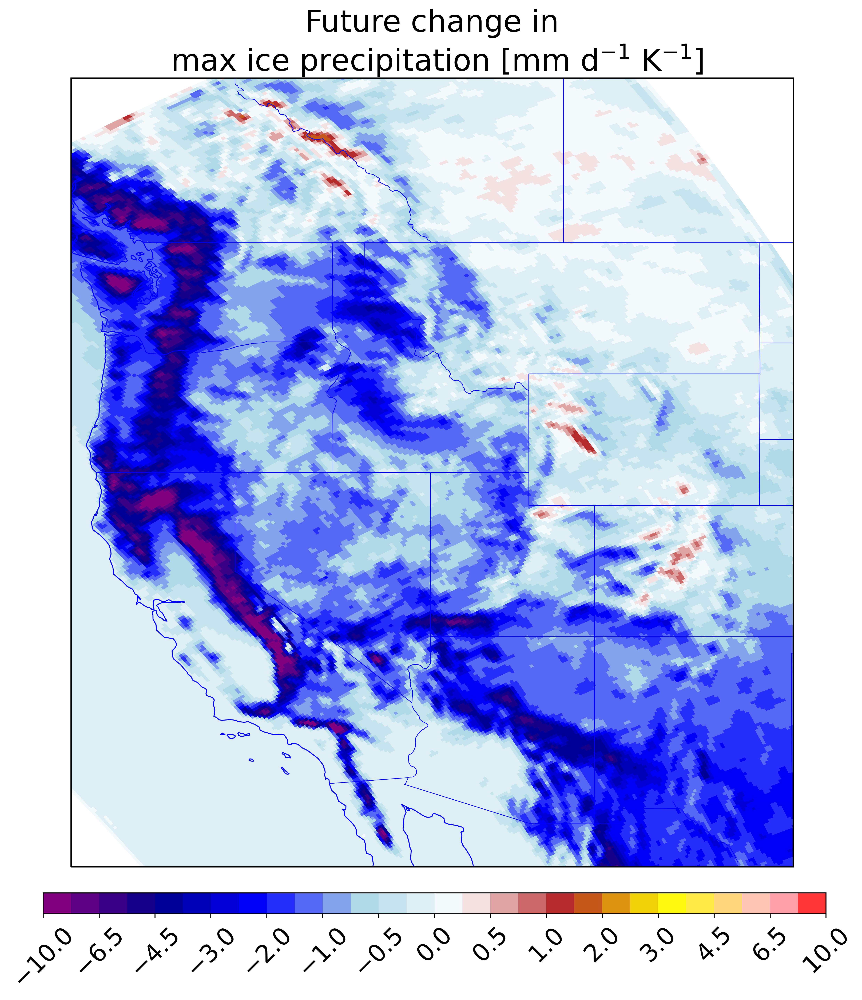

In [183]:
%%time

levs = [-200,-150,-130,-110,-90,-70,-60,-50,-40,-30,-20,-15,-10,-5,0,
        5,10,15,20,30,40,50,60,70,90,110,130,150,200]
levs = np.array(levs) / 20.
mycmap = ["purple","darkblue","blue","lightblue",
          "white",
          "firebrick","yellow","pink","red"]
title = 'Future change in\n max ice precipitation [mm d$^{-1}$ K$^{-1}$]'

diff = max_prec_snow_noBC#.sel(gcm=max_snow_BC.gcm)

diff = diff / global_DeltaTemperatures.mean('month')
print (diff.gcm.values)
print (diff.max().values)
diff = diff.mean('gcm')

_plotSingle(1,levs,mycmap,
                diff,
                title)

gc.collect()

In [185]:
%%time

max_prec_snow_BC = []

for count, igcm in enumerate(prec_snow_BC.keys()):

    max_prec_snow_BC.append( _rx1(prec_snow_BC[igcm]) )
    
    print (igcm)

max_prec_snow_BC = xr.concat(max_prec_snow_BC,dim='gcm')
max_prec_snow_BC['gcm'] = keys[0:9]

gc.collect()

cesm2_r11i1p1f1_ssp370
mpi-esm1-2-lr_r7i1p1f1_ssp370
cnrm-esm2-1_r1i1p1f2_ssp370
ec-earth3-veg_r1i1p1f1_ssp370
fgoals-g3_r1i1p1f1_ssp370
ukesm1-0-ll_r2i1p1f2_ssp370
canesm5_r1i1p2f1_ssp370
access-cm2_r5i1p1f1_ssp370
ec-earth3_r1i1p1f1_ssp370
CPU times: user 2min 57s, sys: 3min 48s, total: 6min 45s
Wall time: 3min 32s


12470

['cesm2_r11i1p1f1_ssp370' 'mpi-esm1-2-lr_r7i1p1f1_ssp370'
 'cnrm-esm2-1_r1i1p1f2_ssp370' 'ec-earth3-veg_r1i1p1f1_ssp370'
 'fgoals-g3_r1i1p1f1_ssp370' 'ukesm1-0-ll_r2i1p1f2_ssp370'
 'canesm5_r1i1p2f1_ssp370' 'access-cm2_r5i1p1f1_ssp370'
 'ec-earth3_r1i1p1f1_ssp370']
5.2380866233216965
CPU times: user 767 ms, sys: 16.4 ms, total: 783 ms
Wall time: 776 ms


83

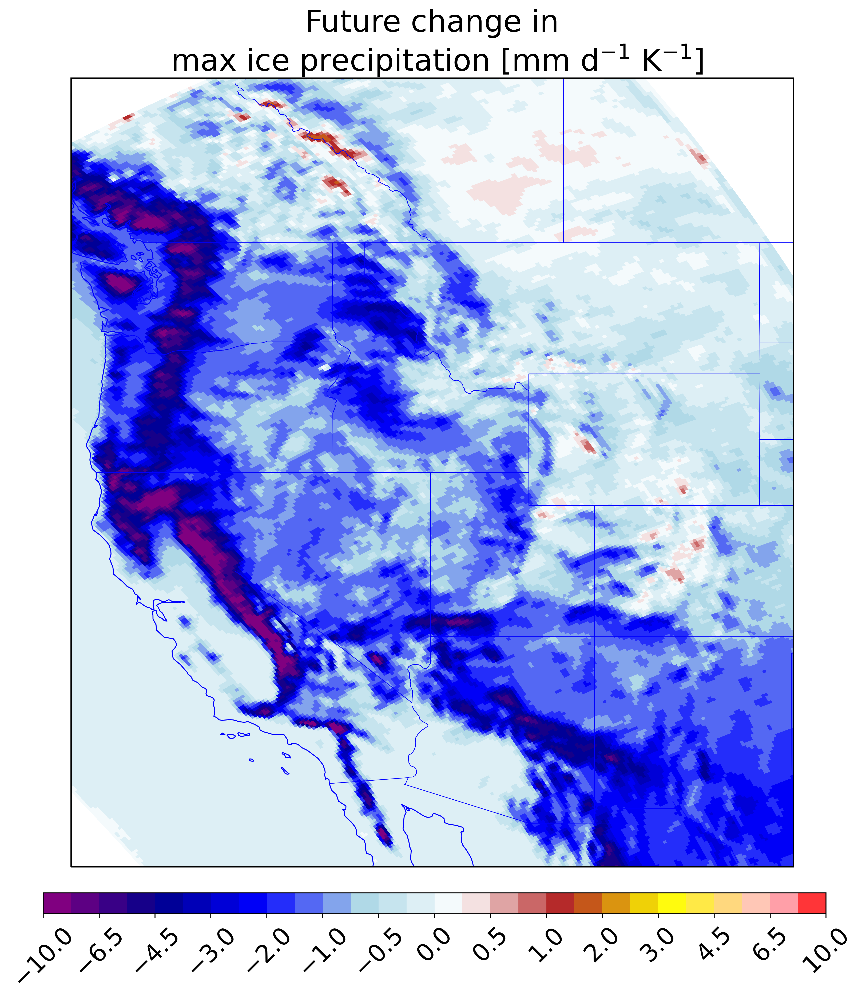

In [186]:
%%time

levs = [-200,-150,-130,-110,-90,-70,-60,-50,-40,-30,-20,-15,-10,-5,0,
        5,10,15,20,30,40,50,60,70,90,110,130,150,200]
levs = np.array(levs) / 20.
mycmap = ["purple","darkblue","blue","lightblue",
          "white",
          "firebrick","yellow","pink","red"]
title = 'Future change in\n max ice precipitation [mm d$^{-1}$ K$^{-1}$]'

diff = max_prec_snow_noBC.sel(gcm=max_snow_BC.gcm)

diff = diff / global_DeltaTemperatures.mean('month')
print (diff.gcm.values)
print (diff.max().values)
diff = diff.mean('gcm')

_plotSingle(1,levs,mycmap,
                diff,
                title)

gc.collect()

['cesm2_r11i1p1f1_ssp370' 'mpi-esm1-2-lr_r7i1p1f1_ssp370'
 'cnrm-esm2-1_r1i1p1f2_ssp370' 'ec-earth3-veg_r1i1p1f1_ssp370'
 'fgoals-g3_r1i1p1f1_ssp370' 'ukesm1-0-ll_r2i1p1f2_ssp370'
 'canesm5_r1i1p2f1_ssp370' 'access-cm2_r5i1p1f1_ssp370'
 'ec-earth3_r1i1p1f1_ssp370']
5.995198312081961
CPU times: user 839 ms, sys: 39.1 ms, total: 878 ms
Wall time: 868 ms


5301

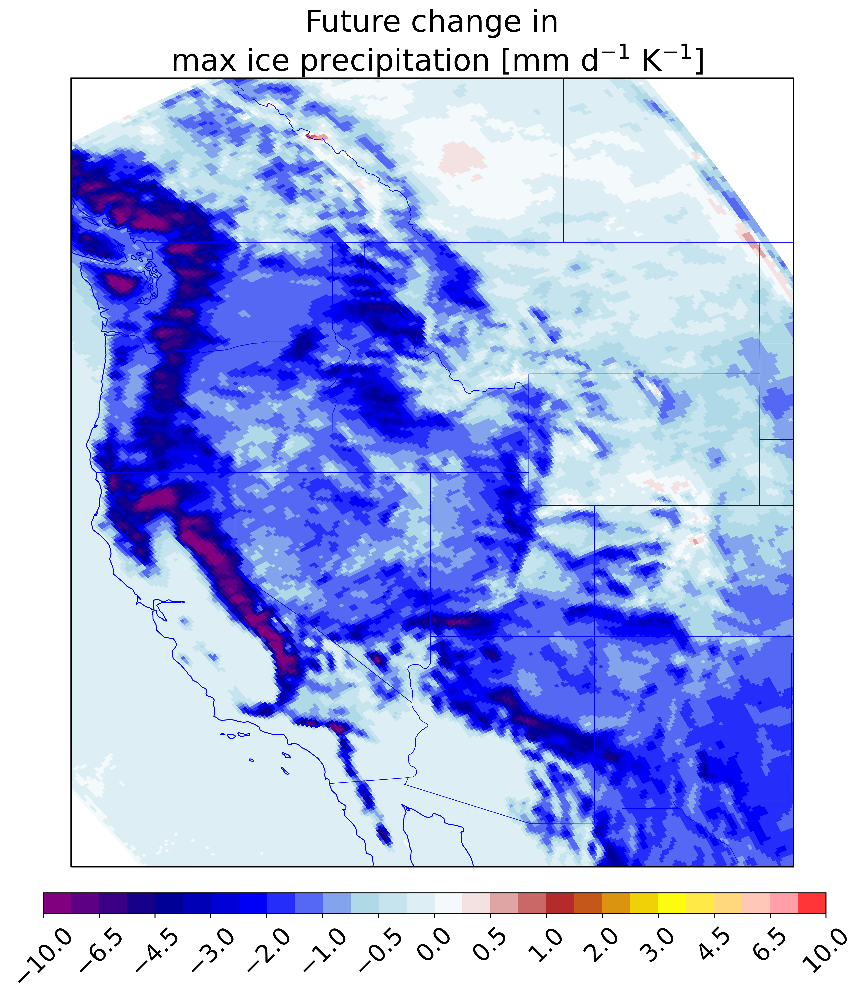

In [187]:
%%time

levs = [-200,-150,-130,-110,-90,-70,-60,-50,-40,-30,-20,-15,-10,-5,0,
        5,10,15,20,30,40,50,60,70,90,110,130,150,200]
levs = np.array(levs) / 20.
mycmap = ["purple","darkblue","blue","lightblue",
          "white",
          "firebrick","yellow","pink","red"]
title = 'Future change in\n max ice precipitation [mm d$^{-1}$ K$^{-1}$]'

diff = max_prec_snow_BC

diff = diff / global_DeltaTemperatures.mean('month')
print (diff.gcm.values)
print (diff.max().values)
diff = diff.mean('gcm')

_plotSingle(1,levs,mycmap,
                diff,
                title)

gc.collect()

# Elevational dependencies

In [116]:
%%time

#What year do simulations
#reach x percentile
#of historical climo
q = [0.001,0.01,0.1]
array = snow_SNOTELfromWRF_BC.mean('gcm').sel(time=snow_SNOTELfromWRF_BC.time.dt.month == 4)
historical = array.sel(time=slice('1981','2010'))
p_historical_BC = historical.quantile(q,'time',keep_attrs=False)

print (p_historical_BC)

array = snow_SNOTELfromWRF_noBC.mean('gcm').sel(time=snow_SNOTELfromWRF_noBC.time.dt.month == 4)
historical = array.sel(time=slice('1981','2010'))
p_historical_noBC = historical.quantile(q,'time',keep_attrs=False)

print (p_historical_noBC)

'''array = snow_SNOTELfromWRF_BC.sel(time=snow_SNOTELfromWRF_BC.time.dt.month == 4)
rolled = array.rolling(time=30,center=True).mean('time')

rolled.isel(gcm=0,site=0).plot()
array.isel(gcm=0,site=0).plot()
print ( array.isel(gcm=0,site=0).mean('time').values )
print ( p_historical.isel(site=0).values )
'''
gc.collect()

<xarray.DataArray (quantile: 3, site: 703)>
array([[4.96192471e+00, 4.36774100e-02, 7.97573406e+00, ...,
        2.48897547e+02, 6.68611935e+01, 3.44243089e+01],
       [6.98203291e+00, 2.75318360e-01, 8.41272231e+00, ...,
        2.52854089e+02, 7.04781917e+01, 3.47518741e+01],
       [1.61739379e+01, 1.96762040e+00, 2.27801943e+01, ...,
        2.78881271e+02, 9.26747627e+01, 4.41510571e+01]])
Coordinates:
    lat       (site) float32 36.34 35.27 35.25 35.1 ... 41.04 42.7 41.38 44.37
    lon       (site) float32 -109.1 -112.1 -111.7 ... -109.4 -107.2 -107.0
    zWRF      (site) float32 2.49e+03 2.16e+03 2.375e+03 ... 2.389e+03 2.6e+03
  * quantile  (quantile) float64 0.001 0.01 0.1
Dimensions without coordinates: site
<xarray.DataArray (quantile: 3, site: 703)>
array([[137.9537101 ,  59.96782397, 147.0552243 , ..., 340.78028751,
        232.99248157,  99.27331061],
       [145.10159988,  60.85405151, 155.12154846, ..., 345.20735504,
        233.90754272,  99.55685181],
       [194.44

20

CPU times: user 396 ms, sys: 6.49 ms, total: 403 ms
Wall time: 397 ms


5101

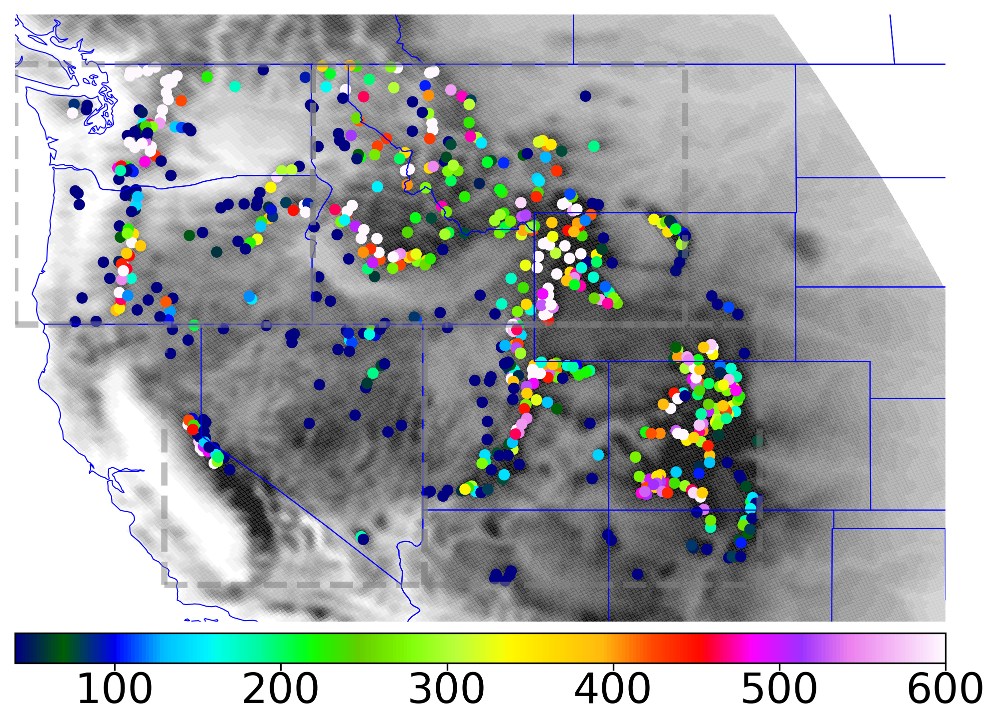

In [241]:
%%time

from mpl_toolkits.axes_grid1.inset_locator import inset_axes

levs = np.arange(0,2701,100)
mycmap = ['white','black']

norm = matplotlib.colors.BoundaryNorm(levs,len(levs))
colors_to_rgb = []
for ii in mycmap:
    aa = colors.to_rgba(ii)
    colors_to_rgb.append(aa)
cmap = LinearSegmentedColormap.from_list("t2",colors_to_rgb,len(levs)-1)

fig = P.figure(1,figsize=(8,8),dpi=300)
fig.patch.set_facecolor('xkcd:white')
cart_proj = crs.PlateCarree()
ax = P.subplot(1,1,1,projection=cart_proj)

cs = ax.pcolormesh(lon_wrf,lat_wrf,z_wrf, \
            cmap=cmap,norm=norm,alpha=0.8)

#Scatter
qx = p_historical_BC.sel(quantile=0.01)
cs = ax.scatter(qx.lon,qx.lat,c=qx,s=20,marker='o' ,
          cmap=P.cm.gist_ncar,
               vmin=40,vmax=600)

ax.outline_patch.set_visible(False)
ax.add_feature(states, linewidth=.5, edgecolor="blue")
ax.set_extent([-125,-100,34,50])

#Pacific NW
lat_ll, lat_ur, lon_ll, lon_ur = 42., 49., -125., -117.
ax.plot([lon_ll,lon_ll],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ur,lon_ur],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ll,lat_ll],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ur,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)

#North-Central Rockies
lat_ll, lat_ur, lon_ll, lon_ur = 42., 49., -117., -107.
ax.plot([lon_ll,lon_ll],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ur,lon_ur],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ll,lat_ll],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ur,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)

#South-Central Rockies
lat_ll, lat_ur, lon_ll, lon_ur = 35., 42., -114., -105.
ax.plot([lon_ll,lon_ll],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ur,lon_ur],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ll,lat_ll],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ur,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)

#Southwest
lat_ll, lat_ur, lon_ll, lon_ur = 35., 42., -121., -114.
ax.plot([lon_ll,lon_ll],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ur,lon_ur],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ll,lat_ll],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ur,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)


axins = inset_axes(ax,
                    width="100%",  
                    height="5%",
                    loc='lower center',
                    borderpad=-2
                   )

cb = fig.colorbar(cs,cax=axins,orientation='horizontal')
cb.ax.tick_params(labelsize=20,rotation=0,pad=0)

gc.collect()

In [188]:
%%time

def _linregress_3D(y_array):
    # y_array is a 3-D array formatted like (time,lon,lat)
    # The purpose of this function is to do linear regression using time series of data over each (lon,lat) grid box with consideration of ignoring np.nan
    # Construct x_array indicating time indexes of y_array, namely the independent variable.
    x_array=np.empty(y_array.shape)
    for i in range(y_array.shape[0]): x_array[i,:,:]=i+1 # This would be fine if time series is not too long. Or we can use i+yr (e.g. 2019).
    x_array[np.isnan(y_array)]=np.nan
    # Compute the number of non-nan over each (lon,lat) grid box.
    n=np.sum(~np.isnan(x_array),axis=0)
    # Compute mean and standard deviation of time series of x_array and y_array over each (lon,lat) grid box.
    x_mean=np.nanmean(x_array,axis=0)
    y_mean=np.nanmean(y_array,axis=0)
    x_std=np.nanstd(x_array,axis=0)
    y_std=np.nanstd(y_array,axis=0)
    # Compute co-variance between time series of x_array and y_array over each (lon,lat) grid box.
    cov=np.nansum((x_array-x_mean)*(y_array-y_mean),axis=0)/n
    # Compute correlation coefficients between time series of x_array and y_array over each (lon,lat) grid box.
    cor=cov/(x_std*y_std)
    # Compute slope between time series of x_array and y_array over each (lon,lat) grid box.
    slope=cov/(x_std**2)
    # Compute intercept between time series of x_array and y_array over each (lon,lat) grid box.
    intercept=y_mean-x_mean*slope
    # Compute tstats, stderr, and p_val between time series of x_array and y_array over each (lon,lat) grid box.
    tstats=cor*np.sqrt(n-2)/np.sqrt(1-cor**2)
    stderr=slope/tstats
    from scipy.stats import t
    p_val=t.sf(tstats,n-2)*2
    # Compute r_square and rmse between time series of x_array and y_array over each (lon,lat) grid box.
    # r_square also equals to cor**2 in 1-variable lineare regression analysis, which can be used for checking.
    r_square=np.nansum((slope*x_array+intercept-y_mean)**2,axis=0)/np.nansum((y_array-y_mean)**2,axis=0)
    rmse=np.sqrt(np.nansum((y_array-slope*x_array-intercept)**2,axis=0)/n)
    # Do further filteration if needed (e.g. We stipulate at least 3 data records are needed to do regression analysis) and return values
    n=n*1.0 # convert n from integer to float to enable later use of np.nan
    n[n<3]=np.nan
    slope[np.isnan(n)]=np.nan
    intercept[np.isnan(n)]=np.nan
    p_val[np.isnan(n)]=np.nan
    r_square[np.isnan(n)]=np.nan
    rmse[np.isnan(n)]=np.nan
    
    coords_x = {'gcm':(['gcm'],y_array.gcm),
                'site':(['site'],y_array.site),
                'lat':(['site'],y_array.lat),
                'lon':(['site'],y_array.lon),
                'zWRF':(['site'],y_array.zWRF)}
    slope = xr.DataArray(slope,dims=['gcm','site'],coords=coords_x)
    intercept = xr.DataArray(intercept,dims=['gcm','site'],coords=coords_x)

    return ([slope.mean('gcm'),intercept.mean('gcm')])

#print (snow_SNOTELfromWRF_BC)
gc.collect()

CPU times: user 324 ms, sys: 5.36 ms, total: 330 ms
Wall time: 326 ms


0

In [192]:
%%time

snow_array = snow_SNOTELfromWRF_BC.sel(time=snow_SNOTELfromWRF_BC.time.dt.month==4)
trends_snow_BC = _linregress_3D(snow_array.transpose('time','gcm','site'))

snow_array = snow_SNOTELfromWRF_noBC.sel(time=snow_SNOTELfromWRF_noBC.time.dt.month==4)
trends_snow_noBC = _linregress_3D(snow_array.transpose('time','gcm','site'))

gc.collect()

/work/srahimi/clone/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: invalid value encountered in true_divide
/work/srahimi/clone/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in true_divide
/work/srahimi/clone/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: invalid value encountered in true_divide
/work/srahimi/clone/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in true_divide


CPU times: user 507 ms, sys: 8.48 ms, total: 515 ms
Wall time: 509 ms


20

# Find year when trend arrays fall below percentile of historical period

CPU times: user 1.8 s, sys: 27.9 ms, total: 1.83 s
Wall time: 1.81 s


55040

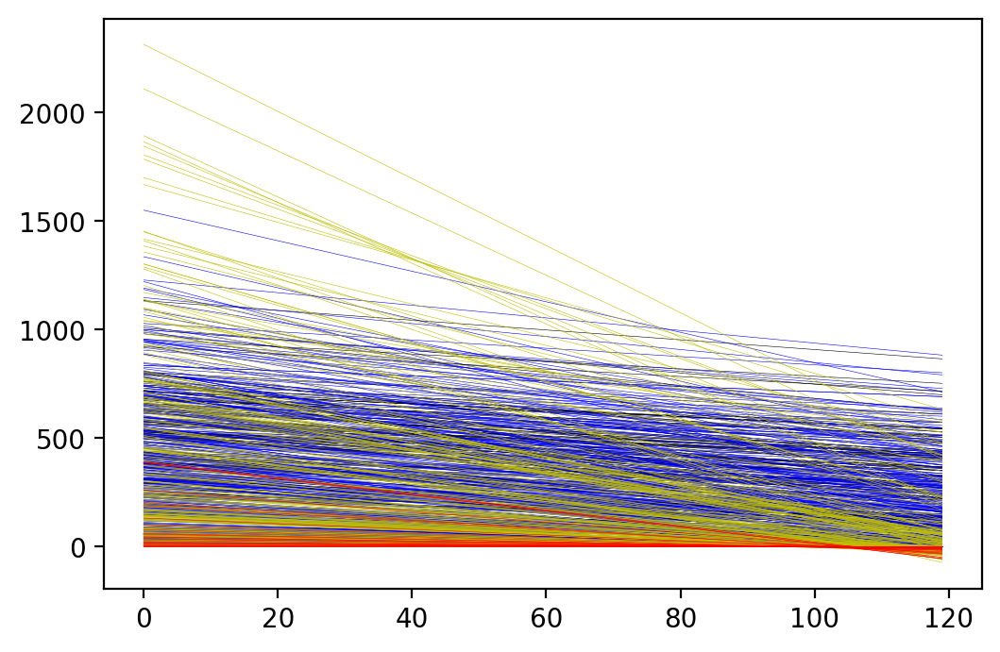

In [199]:
%%time

#Check the linear trends

x = np.arange(0,120,1)

P.figure(dpi=200)
for icount, isite in enumerate(trends_snow_BC[0].site):
    y = trends_snow_BC[1].sel(site=isite).values + \
    x*trends_snow_BC[0].sel(site=isite).values

    elev = isite.zWRF.values
    
    if elev < 1000:
        c = 'r'
        P.plot(x,y,linewidth=0.2,c=c,zorder=5)
    if elev >= 1000 and elev < 2000:
        c = 'y'
        P.plot(x,y,linewidth=0.2,c=c,zorder=4)
    if elev >= 2000 and elev < 3000:
        c = 'b'
        P.plot(x,y,linewidth=0.2,c=c)
    if elev >= 3000:
        c = 'k'
        P.plot(x,y,linewidth=0.2,c=c)        
        
gc.collect()

In [237]:
%%time

percentile = p_historical_BC.sel(quantile=0.01)

x = np.arange(0,120,1)
years = x + 1981.
years = xr.DataArray(years,dims=['year'],
                     coords={'year':(['year'],years)})

count = 0
sum = 0
year_of_sadness = []
for icount, isite in enumerate(trends_snow_BC[0].site):
    y = trends_snow_BC[1].sel(site=isite).values + \
    x*trends_snow_BC[0].sel(site=isite).values
    y = xr.DataArray(y,dims=['year'],
                 coords={'year':(['year'],years)})

    diff = y - percentile.sel(site=isite)
    minimum_year = xr.ufuncs.fabs(diff).argmin()
    iyear = diff.year.isel(year=minimum_year).values
    
    year_of_sadness.append(iyear)
    
    if iyear < 2030:
        '''P.figure(icount+1)
        diff.plot()'''
        count = count + 1
        sum = sum + percentile.sel(site=isite).zWRF.values

y_array = trends_snow_BC[0]
coords_x = {
            'site':(['site'],y_array.site),
            'lat':(['site'],y_array.lat),
            'lon':(['site'],y_array.lon),
            'zWRF':(['site'],y_array.zWRF)}
year_of_sadness_BC = xr.DataArray(year_of_sadness,dims=['site'],
                                                    coords=coords_x)

print ('Number of sites below 10th percentile before 2030:',count)
print ('Average elevation of these sites:', sum/count)

gc.collect()

Number of sites below 10th percentile before 2030: 94
Average elevation of these sites: 1638.0295877659576
CPU times: user 2.6 s, sys: 81.5 ms, total: 2.68 s
Wall time: 2.58 s


0

CPU times: user 392 ms, sys: 6.41 ms, total: 398 ms
Wall time: 395 ms


3881

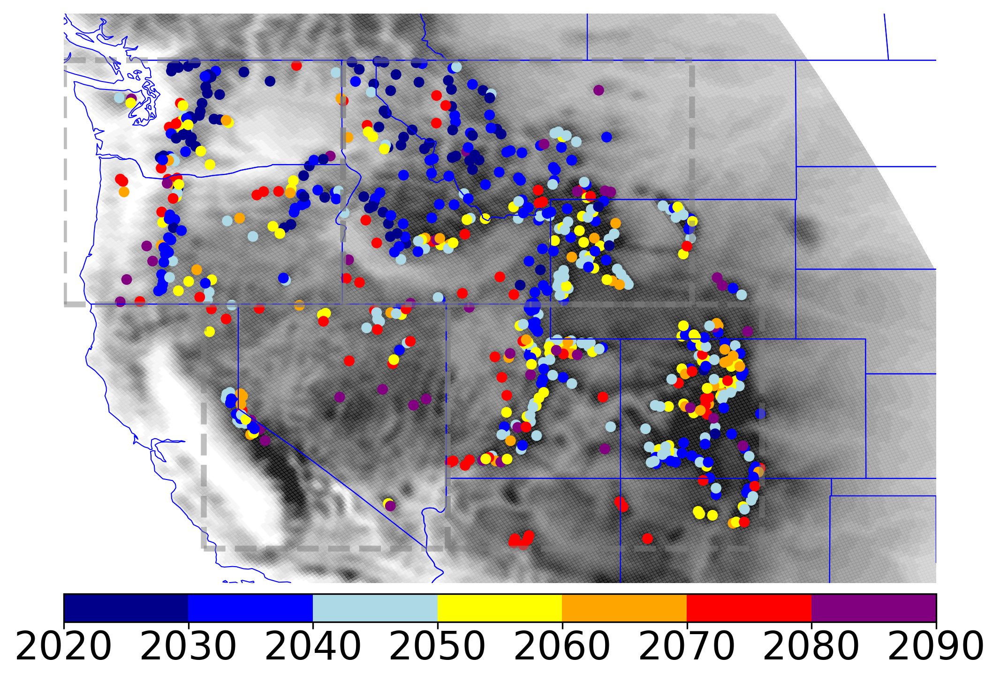

In [240]:
%%time

from mpl_toolkits.axes_grid1.inset_locator import inset_axes

levs = np.arange(0,2701,100)
mycmap = ['white','black']

norm = matplotlib.colors.BoundaryNorm(levs,len(levs))
colors_to_rgb = []
for ii in mycmap:
    aa = colors.to_rgba(ii)
    colors_to_rgb.append(aa)
cmap = LinearSegmentedColormap.from_list("t2",colors_to_rgb,len(levs)-1)

fig = P.figure(1,figsize=(8,8),dpi=300)
fig.patch.set_facecolor('xkcd:white')
cart_proj = crs.PlateCarree()
ax = P.subplot(1,1,1,projection=cart_proj)

cs = ax.pcolormesh(lon_wrf,lat_wrf,z_wrf, \
            cmap=cmap,norm=norm,alpha=0.8)

#Scatter

mycmap = ['darkblue','blue','lightblue',
          'yellow',
          'orange','red','purple']
levs = np.arange(2020,2091,10)

norm = matplotlib.colors.BoundaryNorm(levs,len(levs))
colors_to_rgb = []
for ii in mycmap:
    aa = colors.to_rgba(ii)
    colors_to_rgb.append(aa)
cmap = LinearSegmentedColormap.from_list("t2",colors_to_rgb,len(levs)-1)

#Exclude values < 2020
qx = year_of_sadness_BC.where(year_of_sadness_BC>2020,np.nan)
cs = ax.scatter(qx.lon,qx.lat,c=qx,s=20,marker='o' ,
          cmap=cmap,
               vmin=np.min(levs),vmax=np.max(levs))

ax.outline_patch.set_visible(False)
ax.add_feature(states, linewidth=.5, edgecolor="blue")
ax.set_extent([-125,-100,34,50])


#Pacific NW
lat_ll, lat_ur, lon_ll, lon_ur = 42., 49., -125., -117.
ax.plot([lon_ll,lon_ll],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ur,lon_ur],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ll,lat_ll],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ur,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)

#North-Central Rockies
lat_ll, lat_ur, lon_ll, lon_ur = 42., 49., -117., -107.
ax.plot([lon_ll,lon_ll],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ur,lon_ur],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ll,lat_ll],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ur,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)

#South-Central Rockies
lat_ll, lat_ur, lon_ll, lon_ur = 35., 42., -114., -105.
ax.plot([lon_ll,lon_ll],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ur,lon_ur],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ll,lat_ll],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ur,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)

#Southwest
lat_ll, lat_ur, lon_ll, lon_ur = 35., 42., -121., -114.
ax.plot([lon_ll,lon_ll],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ur,lon_ur],[lat_ll,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ll,lat_ll],linestyle="--",color='gray',linewidth=3,alpha=0.5)
ax.plot([lon_ll,lon_ur],[lat_ur,lat_ur],linestyle="--",color='gray',linewidth=3,alpha=0.5)

axins = inset_axes(ax,
                    width="100%",  
                    height="5%",
                    loc='lower center',
                    borderpad=-2
                   )

cb = fig.colorbar(cs,cax=axins,orientation='horizontal')
cb.ax.tick_params(labelsize=20,rotation=0,pad=0)

gc.collect()

In [236]:
%%time

year_array = year_of_sadness_BC.where(year_of_sadness_BC>2020,np.nan)
percentile_array = p_historical_BC.sel(quantile=0.01)

#Correlation of exceedance year with percentile magnitude
print ( np.round( xr.corr(year_array,percentile_array),2 ).values )

#Correlation between percentile and elevation
print ( np.round( xr.corr(year_array.zWRF,percentile_array),2 ).values )

#Correlation between exceedance year and elevation
print ( np.round( xr.corr(year_array.zWRF,year_array),2 ).values )

gc.collect()

-0.38
0.19
0.07
CPU times: user 348 ms, sys: 6.16 ms, total: 354 ms
Wall time: 346 ms


0